<a href="https://colab.research.google.com/github/aneel10/dl-semi-project/blob/master/DraftGan_PIX2PIX.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Image Inpainting 🐱**
**Name Student 1:** Yam Libman **ID Student 1:** 205935463


**Name Student 2:** Anil Azam **ID Student 2:** 318932357


**Name Student 3:** Gosha Shapira **ID Student 3:** 321328296


**Name Student 4:** Dima Valdiko **ID Student 4:** 320721797



<a align="bottom left"  target="_blank">
<img width="500", src="https://i.ytimg.com/vi/dx-K_fAp2ow/maxresdefault.jpg"></a>

In this notebook we're going to conduct 4 experiments of Inpaiting cats' images.


the notebook and the experience is based on the following articles:

1. ['Context Encoders: Feature Learning by Inpainting'](https://arxiv.org/pdf/1604.07379.pdf)
2. ['Image-to-Image Translation with Conditional Adversarial Networks'](https://arxiv.org/pdf/1611.07004.pdf)

challenge accepted... 😏



# **Data Preprocessing 🚧**

the whole Data Preprocessing is fit for all the experiment so we only need to do it once



In [1]:
#upgarde to tf 2.8.0
!pip install --upgrade tensorflow

In [2]:
#import related libraries
import os
import glob
import imageio
import numpy as np
from tqdm import tqdm
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
from tensorflow.keras import layers
from tensorflow.keras import Model
from tensorflow.keras import initializers

# Defining the global variables.
IMAGE_SIZE = (256, 256)
BATCH_SIZE = 64
EPOCHS = 40
AUTOTUNE = tf.data.AUTOTUNE

In [3]:
#mount my colab
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**creating new folders for both cats and missing cats with same photos converted to jpeg due to some limitations in Keras API**

In [ ]:
from PIL import Image
from pathlib import Path

def create_jpeg_folder(path, new_path):
  
  imagelist = os.listdir(path)

  for image in imagelist:
    img = Image.open(f'{path}/{image}')
    new_img = img.convert('RGB')
    image = Path(image)
    image = image.with_suffix('.jpeg')
    new_img.save(f'{new_path}/{image}')

create_jpeg_folder('/content/drive/MyDrive/Education/csDegree/thirdYear/firstSemester/DLcourse/FinalTaskGANs/set/cats','/content/drive/MyDrive/Education/csDegree/thirdYear/firstSemester/DLcourse/FinalTaskGANs/set_jpeg/cats')
create_jpeg_folder('/content/drive/MyDrive/Education/csDegree/thirdYear/firstSemester/DLcourse/FinalTaskGANs/set/cat_missing','/content/drive/MyDrive/Education/csDegree/thirdYear/firstSemester/DLcourse/FinalTaskGANs/set_jpeg/cat_missing')

**create tensorflow dataset ready to train with validation and test seperated datasets**


using mini functions to help and the main function for the dataset creation is 'create_dataset_imageinpainting'


In [4]:
#function that gets a path for an image and return tensorflow image resized and decoded

import sys
from PIL import Image
import numpy as np

def decode_and_resize(image_path):

  image = tf.io.read_file(image_path)
  image = tf.io.decode_jpeg(image, channels=3)
  image = tf.image.convert_image_dtype(image, dtype="float32")
  #image = tf.cast(image, tf.float32) / 127.5 - 1

  max = tf.reduce_max(image)
  min = tf.reduce_min(image)

  #image = (((image - min) / (max - min))) * 255

  image = tf.image.resize(image, IMAGE_SIZE)
  
  return image

In [5]:
#function that takes paths for real cats and missing cats and put their name in Python list

def create_simple_dataset(folder_path_real, folder_path_miss):

  images = os.listdir(folder_path_real)
  real_images = [os.path.join(folder_path_real, image) for image in images]
  miss_images = [os.path.join(folder_path_miss, image) for image in images]
  return real_images, miss_images


In [6]:
#function that gets a Python list and return three python lists for train, val and test

def create_train_val_test(simple_dataset):

  total_dataset_images = len(simple_dataset)
  train_dataset = simple_dataset[: int(0.8 * total_dataset_images)]
  val_dataset = simple_dataset[int(0.8 * total_dataset_images) : int(0.9 * total_dataset_images)]
  test_dataset = simple_dataset[int(0.9 * total_dataset_images) :]
  
  return train_dataset, val_dataset, test_dataset

In [7]:
#function that gets python list contains paths for images and return tf.Datset with those images

def build_tf_dataset(simple_dataset):

  tensorflow_dataset = (tf.data.Dataset.from_tensor_slices(simple_dataset).map(decode_and_resize, num_parallel_calls=AUTOTUNE).repeat())
  
  return tensorflow_dataset

In [8]:
#function that gets a couple of tf.Datsets and return zip tf.Dataset

def build_zip_dataset(real_dataset, missing_dataset):

  zip_dataset = (tf.data.Dataset.zip((real_dataset, missing_dataset)).shuffle(BATCH_SIZE * 2).batch(BATCH_SIZE).prefetch(AUTOTUNE))

  return zip_dataset

In [9]:
#main function for Dataset building

def create_dataset_imageinpainting(real_images_path, missing_images_path):

  real_images, missing_images  = create_simple_dataset(real_images_path, missing_images_path)
  
  real_images_train, real_images_val, real_images_test = create_train_val_test(real_images)
  missing_images_train, missing_images_val, missing_images_test = create_train_val_test(missing_images)
  

  real_images_train = build_tf_dataset(real_images_train)
  real_images_val = build_tf_dataset(real_images_val)
  real_images_test = build_tf_dataset(real_images_test)

  
  missing_images_train = build_tf_dataset(missing_images_train)
  missing_images_val = build_tf_dataset(missing_images_val)
  missing_images_test = build_tf_dataset(missing_images_test)


  images_train = build_zip_dataset(real_images_train,missing_images_train)
  images_val = build_zip_dataset(real_images_val,missing_images_val)
  images_test = build_zip_dataset(real_images_test,missing_images_test)

  return images_train,images_val,images_test   
  




call to create_dataset_imageinpainting function and create the datasets

In [10]:
#call the function for zip tf.Dataset creation
images_train, images_val, images_test = create_dataset_imageinpainting('/content/drive/MyDrive/Education/csDegree/thirdYear/firstSemester/DLcourse/FinalTaskGANs/set_jpeg/cats', '/content/drive/MyDrive/Education/csDegree/thirdYear/firstSemester/DLcourse/FinalTaskGANs/set_jpeg/cat_missing')

checking a few photo sets to verify the datasets are OK 😀

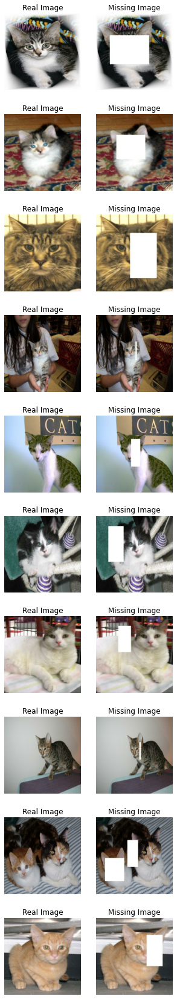

In [11]:
# checking our dataset is Ok by showing us some pairs of images
import math
from math import *

real, missing = next(iter(images_val))


fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(5, 30))
[ax.axis("off") for ax in np.ravel(axes)]


for (axis, real_image, missing_image) in zip(axes, real[0:10], missing[0:10]):
    (ax_style, ax_content) = axis

    ax_style.imshow(real_image)
    ax_style.set_title("Real Image")

    ax_content.imshow(missing_image)
    ax_content.set_title("Missing Image")








# **Experiment number 1: 🧪** 

the experiment is basted on model proposed in the article.

further information ahead 😀

## **Model building and architecture 👷**

the architecture and the model building proccess is all based on the article:

['Context Encoders: Feature Learning by Inpainting'](https://arxiv.org/pdf/1604.07379.pdf) from Berkeley.

just for first feeling what we're about to do here's the general architecture:

<a align="bottom left"  target="_blank">
<img width="500", src="https://miro.medium.com/max/1400/1*xZ9-q0bGxhi18RAbiBykSQ.png"></a>

### **Generator 🧝**

The generator's architecture is based on Autoencoder structure which was written in the article.

as they mention it's a simple context autoencoder.


*'the overall architecture is a simple encoder-decoder
pipeline. The encoder takes an input image with missing
regions and produces a latent feature representation of that
image. The decoder takes this feature representation and
produces the missing image content italicized text.'*

In [ ]:
class Generator(tf.keras.Model):
  def __init__(self):
    super(Generator, self).__init__()
    self.encoder = tf.keras.Sequential([
      tf.keras.layers.Input(shape=(128, 128, 3)),
      tf.keras.layers.Conv2D(filters=64, kernel_size=2, strides=(2, 2),kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.LeakyReLU(alpha=0.1),
      tf.keras.layers.Conv2D(filters=64, kernel_size=2, strides=(2, 2),kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.LeakyReLU(alpha=0.1),
      tf.keras.layers.Conv2D(filters=128, kernel_size=2, strides=(2, 2),kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.LeakyReLU(alpha=0.1),
      tf.keras.layers.Conv2D(filters=256, kernel_size=2, strides=(2, 2),kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.LeakyReLU(alpha=0.1),
      tf.keras.layers.Conv2D(filters=512, kernel_size=2, strides=(2, 2),kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.LeakyReLU(alpha=0.1),
      tf.keras.layers.Flatten(),
      tf.keras.layers.Dense(units = 4000, activation = 'softmax',kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization()
      ])

    self.decoder = tf.keras.Sequential([
      layers.Input(shape=(4000,)),
      layers.Dense(units = 4*4*512, activation = 'softmax',kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      layers.Reshape(target_shape=(4, 4, 512)),
      layers.Conv2DTranspose(filters=256, kernel_size=2, strides=(2, 2), activation='relu',kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      layers.Conv2DTranspose(filters=128, kernel_size=2, strides=(2, 2), activation='relu',kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      layers.Conv2DTranspose(filters=64, kernel_size=2, strides=(2, 2), activation='relu',kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      layers.Conv2DTranspose(filters=64, kernel_size=2, strides=(2, 2), activation='relu',kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      layers.Conv2DTranspose(filters=3, kernel_size=2, strides=(2, 2), activation='relu',kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization()
      ])

  def call(self, x):
    encoded = self.encoder(x)
    decoded = self.decoder(encoded)
    return decoded


**Encoder summary** 

showing encoder summary to verify everything is Ok 👌
and also for our teacher to have a look on the details inside

In [ ]:
generator = Generator()
generator.build((None,128, 128, 3))
generator.encoder.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_20 (Conv2D)          (None, 64, 64, 64)        832       
                                                                 
 batch_normalization_48 (Bat  (None, 64, 64, 64)       256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_20 (LeakyReLU)  (None, 64, 64, 64)        0         
                                                                 
 conv2d_21 (Conv2D)          (None, 32, 32, 64)        16448     
                                                                 
 batch_normalization_49 (Bat  (None, 32, 32, 64)       256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_21 (LeakyReLU)  (None, 32, 32, 64)       

**Decoder summary** 

showing decoder summary to verify everything is Ok 👌
and also for our teacher to have a look on the details inside

In [ ]:
generator.decoder.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_9 (Dense)             (None, 8192)              32776192  
                                                                 
 batch_normalization_54 (Bat  (None, 8192)             32768     
 chNormalization)                                                
                                                                 
 reshape_4 (Reshape)         (None, 4, 4, 512)         0         
                                                                 
 conv2d_transpose_20 (Conv2D  (None, 8, 8, 256)        524544    
 Transpose)                                                      
                                                                 
 batch_normalization_55 (Bat  (None, 8, 8, 256)        1024      
 chNormalization)                                                
                                                      

**Generator's Loss** 

the Generator's Loss by the article is L2 loss that computes the loss only in the missing area between the generetad and the missing image.

<a align="bottom left"  target="_blank">
<img width="500", src="https://xiaohan-wang.github.io/img/15942152334674.jpg"></a>

**Total Loss** 

the total loss of the context encoder and a combination between the reconstructed loss (generator) and the adverserial loss (discriminator)

the reason we put this kind of loss is to encourage the context encoder to generated less blurry image.

the delta for the generator loss is 0.999


the delta for the discriminator loss is 0.001

<a align="bottom left"  target="_blank">
<img width="500", src="https://miro.medium.com/max/816/1*npi0aogDCNxVXGKtE7braw.png"></a>

In [ ]:
def generator_loss(real,missing,gen_output):

  mask = tf.math.subtract(missing,real)
  real = tf.where(mask>0,real,0)
  gen_output = tf.where(mask>0,gen_output,0)
  subtracted = tf.math.subtract(real,gen_output)
  
  l2_loss = tf.nn.l2_loss(subtracted)
  
  return l2_loss




### **Discriminator 🕵**

the discriminator loss is very similar to the encoder except the output isn't latent dimention layer it's a one unit neuron that tell if the image is real or not

In [ ]:
class Discriminator(tf.keras.Model):
  def __init__(self):
    super(Discriminator, self).__init__()
    self.discriminator = tf.keras.Sequential([
      tf.keras.layers.Input(shape=(128, 128, 3)),
      tf.keras.layers.Conv2D(filters=64, kernel_size=2, strides=(2, 2),kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.LeakyReLU(alpha=0.1),
      tf.keras.layers.Conv2D(filters=64, kernel_size=2, strides=(2, 2),kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.LeakyReLU(alpha=0.1),
      tf.keras.layers.Conv2D(filters=128, kernel_size=2, strides=(2, 2),kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.LeakyReLU(alpha=0.1),
      tf.keras.layers.Conv2D(filters=256, kernel_size=2, strides=(2, 2),kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.LeakyReLU(alpha=0.1),
      tf.keras.layers.Conv2D(filters=512, kernel_size=2, strides=(2, 2),kernel_initializer=initializer),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.LeakyReLU(alpha=0.1),
      tf.keras.layers.Flatten(),
      tf.keras.layers.Dense(units = 1, activation = 'softmax'),
      tf.keras.layers.BatchNormalization()
      ])

  def call(self, x):
    decision = self.discriminator(x)
    return decision

**Discriminator summary** 

showing discriminator summary to verify everything is Ok 👌
and also for our teacher to have a look on the details inside

In [ ]:
#discriminator architecture
discriminator = Discriminator()
discriminator.build((None,128, 128, 3))
discriminator.discriminator.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_30 (Conv2D)          (None, 64, 64, 64)        832       
                                                                 
 batch_normalization_66 (Bat  (None, 64, 64, 64)       256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_30 (LeakyReLU)  (None, 64, 64, 64)        0         
                                                                 
 conv2d_31 (Conv2D)          (None, 32, 32, 64)        16448     
                                                                 
 batch_normalization_67 (Bat  (None, 32, 32, 64)       256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_31 (LeakyReLU)  (None, 32, 32, 64)      

**Discriminator's Loss** 

the Discriminator's Loss is based the idea of GAN.
the Discriminator must distinguish two images in a way that:

1. on the real image the result is 1

2. on the generated image the result is 0

<a align="bottom left"  target="_blank">
<img width="500", src="https://xiaohan-wang.github.io/img/15942164552075.jpg"></a>

In [ ]:
def discriminator_loss(disc_real_output, disc_generated_output):

  loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss


### **The Model 🎨**

The Model is cointaining the relevent data for traning and also managing the training and evaluation part like in Keras.


We managed to do it by inherit "keras.Model" class and overide some of the neccessery methods which was neccessery to fit for our training proccess

In [ ]:

class ImageInpainting(keras.Model):

  def __init__(self, generator, discriminator, **kwargs):
    super().__init__(**kwargs)
    self.generator = generator
    self.discriminator = discriminator
      

  def compile(self, optimizer, loss_generator,discriminator_loss,**kwargs):

    super().compile(**kwargs)
    self.optimizer = optimizer
    self.loss_generator = loss_generator
    self.discriminator_loss = discriminator_loss
    self.generator_loss_tracker = keras.metrics.Mean(name="loss_generator")
    self.discriminator_loss_tracker = keras.metrics.Mean(name="loss_discriminator")
    self.total_loss_tracker = keras.metrics.Mean(name="total_loss") 
      

  @property
  def metrics(self):
    return [
    self.generator_loss_tracker,
    self.discriminator_loss_tracker,
    self.total_loss_tracker]

  def train_discriminator(self, real_images, missing_images):

    with tf.GradientTape() as gradient_tape:
      self.discriminator.trainable = True
      self.generator.trainable = False
      generated_images = self.generator([missing_images])
      pred_real = self.discriminator([real_images])
      pred_fake = self.discriminator([generated_images])
      disc_loss = self.discriminator_loss(pred_real, pred_fake)


    gradients = gradient_tape.gradient(disc_loss, self.discriminator.trainable_variables)
    self.optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
    return disc_loss

  def train_generator(self, real_images, missing_images):

    with tf.GradientTape() as gradient_tape:
      self.generator.trainable = True
      self.discriminator.trainable = False
      generated_images = self.generator(missing_images)

      gen_loss = self.loss_generator(real_images, missing_images, generated_images)
      pred_real = self.discriminator([real_images])
      pred_fake = self.discriminator([generated_images])
      disc_loss = self.discriminator_loss(pred_real, pred_fake)

      total_loss = (gen_loss * 0.999) + (disc_loss * 0.001)

    
    gradients = gradient_tape.gradient(total_loss, self.generator.trainable_variables)

    self.optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
    return total_loss,gen_loss



  @tf.function()
  def train_step(self, data):
    #print(data)
    real, missing  = data
    
    total_loss,loss_generator = self.train_generator(real, missing)
    loss_discriminator = self.train_discriminator(real, missing)

    # Report progress.
    self.generator_loss_tracker.update_state(loss_generator)
    self.discriminator_loss_tracker.update_state(loss_discriminator)
    self.total_loss_tracker.update_state(total_loss)

    results = {m.name: m.result() for m in self.metrics}
    return results

  @tf.function()
  def test_step(self, data):

    
    real, missing  = data
     
    self.discriminator.trainable = False
    self.generator.trainable = False

    generated_images = self.generator([missing])

    gen_loss = self.loss_generator(real, missing, generated_images)

    pred_real = self.discriminator(real)
    pred_fake = self.discriminator(generated_images)
    disc_loss = self.discriminator_loss(pred_real, pred_fake)

    total_loss = (gen_loss * 0.999) + (disc_loss * 0.001)

      # Report progress.
    self.generator_loss_tracker.update_state(gen_loss)
    self.discriminator_loss_tracker.update_state(disc_loss)
    self.total_loss_tracker.update_state(total_loss)

    results = {m.name: m.result() for m in self.metrics}
    return results

  def call(self, inputs):
    missing = inputs
    return self.generator([missing])
        


## **Tracking the Model ⏭**

Just observe numbers in this kind of training proccess isn't enough.

we have to observe also the the proccess of the generation and see each image to see that the proccess is make a progress.

So we create our TrainMonitor class based on "tf.keras.callbacks.Callback" to override the method "on ephoc end" to demend him to show us relevant images during the progress

In [ ]:

class TrainMonitor(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs=None):

    real_train, missing_train = next(iter(images_train))
    real_val, missing_val = next(iter(images_val))
    
    # Encode the style and content image.
    self.real_train = real_train
    self.missing_train = missing_train

    self.real_val = real_val
    self.missing_val = missing_val

    self.train_generated_image = self.model.generator(missing_train)
    Mask_train = keras.layers.Subtract()([self.missing_train, self.real_train])
    self.train_Inpainted_image = keras.layers.Lambda(lambda x: tf.where(x>0,self.train_generated_image,self.missing_train))(Mask_train)

    self.val_generated_image = self.model.generator(missing_val)
    Mask_val = keras.layers.Subtract()([self.missing_val, self.real_val])
    self.val_Inpainted_image = keras.layers.Lambda(lambda x: tf.where(x>0,self.val_generated_image,self.missing_val))(Mask_val)

        # Plot the Style, Content and the NST image.
    fig, ax = plt.subplots(nrows=1, ncols=8, figsize=(20, 5))
    ax[0].imshow(tf.keras.preprocessing.image.array_to_img(self.real_train[0]))
    ax[0].set_title(f"Real_train: {epoch:03d}")

    ax[1].imshow(tf.keras.preprocessing.image.array_to_img(self.missing_train[0]))
    ax[1].set_title(f"Missing_train: {epoch:03d}")

    ax[2].imshow(
            tf.keras.preprocessing.image.array_to_img(self.train_generated_image[0])
        )
    ax[2].set_title(f"Generated_train: {epoch:03d}")

    ax[3].imshow(tf.keras.preprocessing.image.array_to_img(self.train_Inpainted_image[0]))
    ax[3].set_title(f"Inpainted_train: {epoch:03d}")

    ax[4].imshow(
            tf.keras.preprocessing.image.array_to_img(self.real_val[0])
        )
    ax[4].set_title(f"Real_val: {epoch:03d}")

    ax[5].imshow(
            tf.keras.preprocessing.image.array_to_img(self.missing_val[0])
        )
    ax[5].set_title(f"Missing_val: {epoch:03d}")

    ax[6].imshow(
            tf.keras.preprocessing.image.array_to_img(self.val_generated_image[0])
        )
    ax[6].set_title(f"Generated_val: {epoch:03d}")

    ax[7].imshow(
            tf.keras.preprocessing.image.array_to_img(self.val_Inpainted_image[0])
        )
    ax[7].set_title(f"Inpainted_val: {epoch:03d}")

    plt.show()
    plt.close()

## **Train the model 🏋**

the training proccess...

in addition to all the things we've talked about,

here's some more essential information:

1. we added a tensorflow tool called "Tensor Board" that helps us observe the data with graphs during training and also is capable of showing us the data when the google colab is overloaded and just can't.

2. we added a callback with 300 patient because we can see that the whole proccess is going on "zig zag" (this behavior is coming from the fact it's GAN model).
therefore we wanted to give a shot the model to keep training although the validation set is being messy.

anyway, it can't only benefit and not harming (overfitting) because we take eventually the weights with the best validation loss.

3. we used Adam optimizer and learning rate of 2e-4 due to papers recommendation.

4. we set 5000 epochs for anycase but it probablly will end much before due to our callback set up

Epoch 1/5000
89/88 [==============================] - ETA: 0s - loss_generator: 77318.5703 - loss_discriminator: 1.6165 - total_loss: 77241.1953

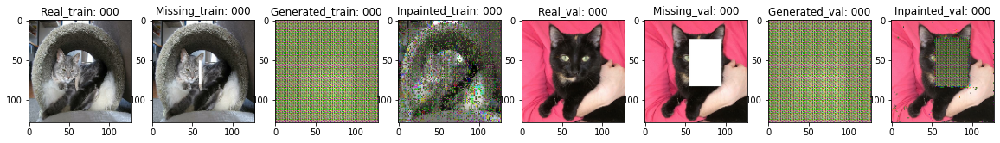

88/88 [==============================] - 66s 690ms/step - loss_generator: 77318.5703 - loss_discriminator: 1.6165 - total_loss: 77241.1953 - val_loss_generator: 28144.9316 - val_loss_discriminator: 1.6055 - val_total_loss: 28116.7930
Epoch 2/5000
89/88 [==============================] - ETA: 0s - loss_generator: 44303.0664 - loss_discriminator: 1.5952 - total_loss: 44258.7617

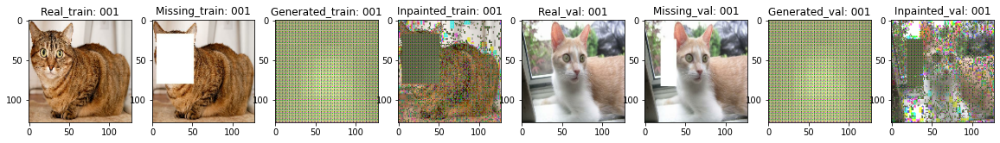

88/88 [==============================] - 28s 321ms/step - loss_generator: 44303.0664 - loss_discriminator: 1.5952 - total_loss: 44258.7617 - val_loss_generator: 24419.8184 - val_loss_discriminator: 1.5849 - val_total_loss: 24395.4043
Epoch 3/5000
89/88 [==============================] - ETA: 0s - loss_generator: 41619.7852 - loss_discriminator: 1.5755 - total_loss: 41578.1641

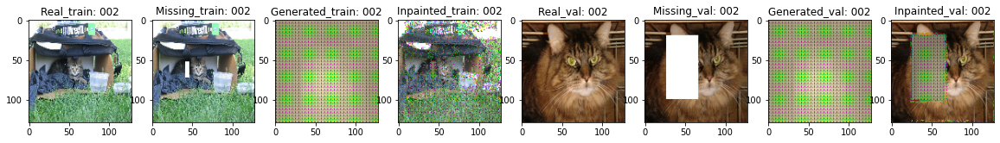

88/88 [==============================] - 60s 682ms/step - loss_generator: 41619.7852 - loss_discriminator: 1.5755 - total_loss: 41578.1641 - val_loss_generator: 23932.2305 - val_loss_discriminator: 1.5661 - val_total_loss: 23908.3008
Epoch 4/5000
89/88 [==============================] - ETA: 0s - loss_generator: 38636.5703 - loss_discriminator: 1.5574 - total_loss: 38597.9414

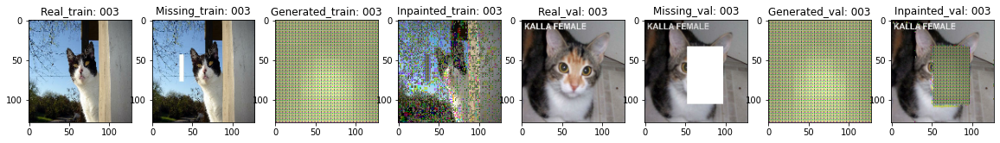

88/88 [==============================] - 28s 319ms/step - loss_generator: 38636.5703 - loss_discriminator: 1.5574 - total_loss: 38597.9414 - val_loss_generator: 23527.5000 - val_loss_discriminator: 1.5488 - val_total_loss: 23503.9668
Epoch 5/5000
89/88 [==============================] - ETA: 0s - loss_generator: 42031.5703 - loss_discriminator: 1.5409 - total_loss: 41989.5391

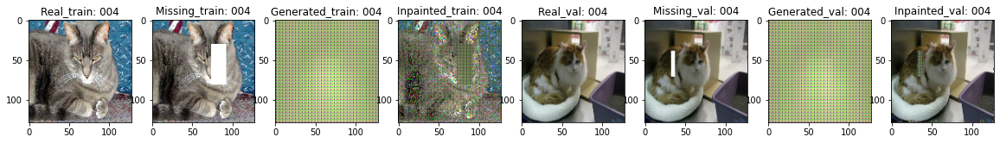

88/88 [==============================] - 36s 412ms/step - loss_generator: 42031.5703 - loss_discriminator: 1.5409 - total_loss: 41989.5391 - val_loss_generator: 23258.7598 - val_loss_discriminator: 1.5330 - val_total_loss: 23235.4980
Epoch 6/5000
89/88 [==============================] - ETA: 0s - loss_generator: 41240.2852 - loss_discriminator: 1.5257 - total_loss: 41199.0547

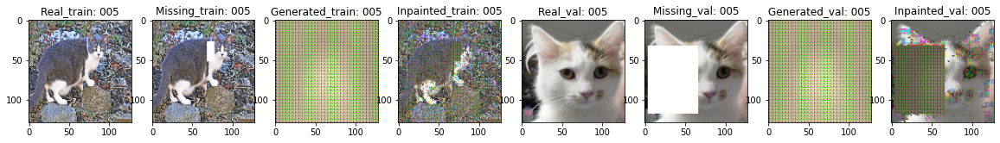

88/88 [==============================] - 32s 368ms/step - loss_generator: 41240.2852 - loss_discriminator: 1.5257 - total_loss: 41199.0547 - val_loss_generator: 22941.7656 - val_loss_discriminator: 1.5185 - val_total_loss: 22918.8223
Epoch 7/5000
89/88 [==============================] - ETA: 0s - loss_generator: 38139.1641 - loss_discriminator: 1.5118 - total_loss: 38101.0156

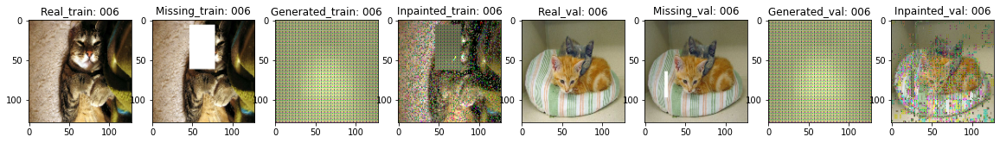

88/88 [==============================] - 26s 298ms/step - loss_generator: 38139.1641 - loss_discriminator: 1.5118 - total_loss: 38101.0156 - val_loss_generator: 22412.0586 - val_loss_discriminator: 1.5052 - val_total_loss: 22389.6523
Epoch 8/5000
89/88 [==============================] - ETA: 0s - loss_generator: 37335.8047 - loss_discriminator: 1.4991 - total_loss: 37298.4609

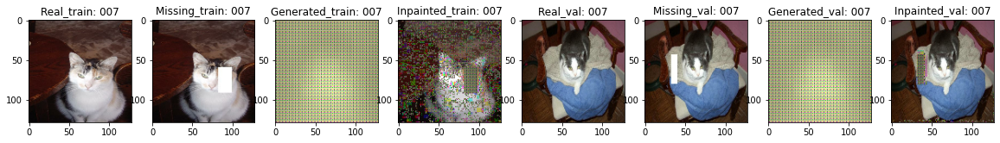

88/88 [==============================] - 32s 366ms/step - loss_generator: 37335.8047 - loss_discriminator: 1.4991 - total_loss: 37298.4609 - val_loss_generator: 22290.2363 - val_loss_discriminator: 1.4931 - val_total_loss: 22267.9531
Epoch 9/5000
89/88 [==============================] - ETA: 0s - loss_generator: 39293.1445 - loss_discriminator: 1.4875 - total_loss: 39253.8594

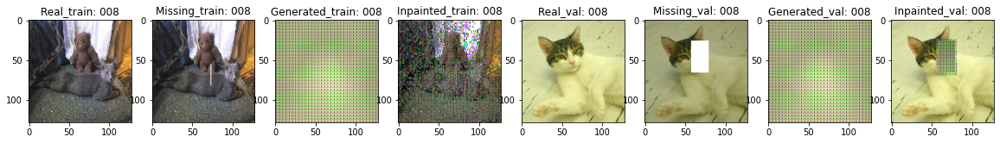

88/88 [==============================] - 32s 363ms/step - loss_generator: 39293.1445 - loss_discriminator: 1.4875 - total_loss: 39253.8594 - val_loss_generator: 21713.8223 - val_loss_discriminator: 1.4820 - val_total_loss: 21692.1113
Epoch 10/5000
89/88 [==============================] - ETA: 0s - loss_generator: 38781.8477 - loss_discriminator: 1.4770 - total_loss: 38743.0664

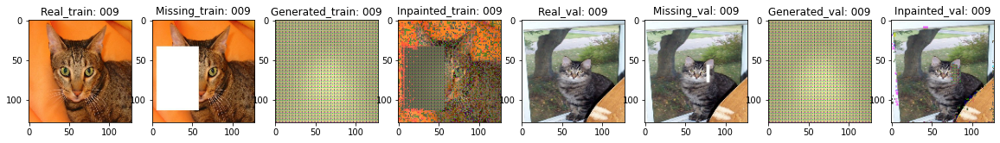

88/88 [==============================] - 26s 298ms/step - loss_generator: 38781.8477 - loss_discriminator: 1.4770 - total_loss: 38743.0664 - val_loss_generator: 21558.9570 - val_loss_discriminator: 1.4719 - val_total_loss: 21537.3984
Epoch 11/5000
89/88 [==============================] - ETA: 0s - loss_generator: 35007.7539 - loss_discriminator: 1.4673 - total_loss: 34972.7539

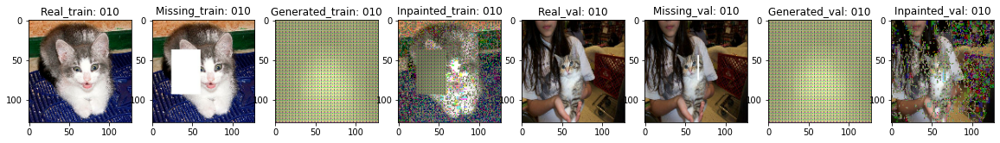

88/88 [==============================] - 27s 307ms/step - loss_generator: 35007.7539 - loss_discriminator: 1.4673 - total_loss: 34972.7539 - val_loss_generator: 20992.1094 - val_loss_discriminator: 1.4627 - val_total_loss: 20971.1211
Epoch 12/5000
89/88 [==============================] - ETA: 0s - loss_generator: 36214.6680 - loss_discriminator: 1.4585 - total_loss: 36178.4609

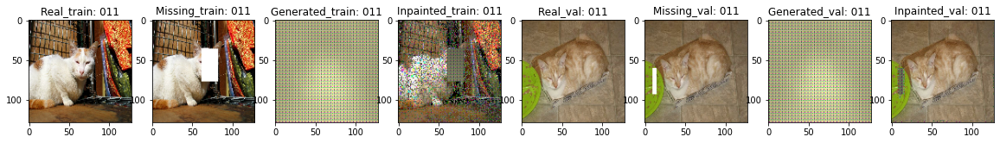

88/88 [==============================] - 27s 305ms/step - loss_generator: 36214.6680 - loss_discriminator: 1.4585 - total_loss: 36178.4609 - val_loss_generator: 21122.1523 - val_loss_discriminator: 1.4543 - val_total_loss: 21101.0391
Epoch 13/5000
89/88 [==============================] - ETA: 0s - loss_generator: 37123.2031 - loss_discriminator: 1.4505 - total_loss: 37086.0859

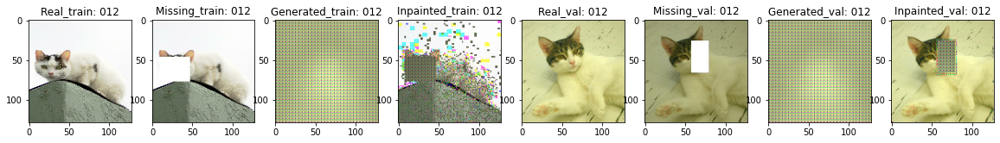

88/88 [==============================] - 32s 364ms/step - loss_generator: 37123.2031 - loss_discriminator: 1.4505 - total_loss: 37086.0859 - val_loss_generator: 20454.0547 - val_loss_discriminator: 1.4467 - val_total_loss: 20433.5977
Epoch 14/5000
89/88 [==============================] - ETA: 0s - loss_generator: 36713.5352 - loss_discriminator: 1.4432 - total_loss: 36676.8242

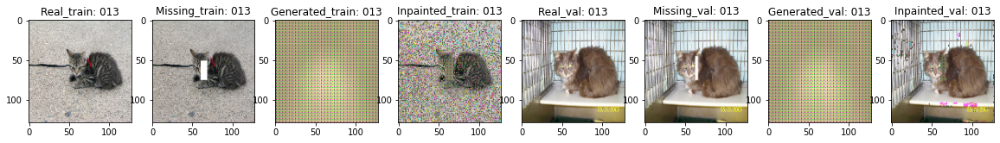

88/88 [==============================] - 27s 306ms/step - loss_generator: 36713.5352 - loss_discriminator: 1.4432 - total_loss: 36676.8242 - val_loss_generator: 20499.7402 - val_loss_discriminator: 1.4398 - val_total_loss: 20479.2422
Epoch 15/5000
89/88 [==============================] - ETA: 0s - loss_generator: 31972.4980 - loss_discriminator: 1.4366 - total_loss: 31940.5254

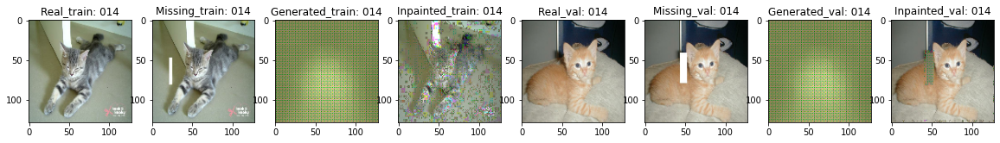

88/88 [==============================] - 32s 361ms/step - loss_generator: 31972.4980 - loss_discriminator: 1.4366 - total_loss: 31940.5254 - val_loss_generator: 19034.5195 - val_loss_discriminator: 1.4335 - val_total_loss: 19015.4844
Epoch 16/5000
89/88 [==============================] - ETA: 0s - loss_generator: 33989.4453 - loss_discriminator: 1.4307 - total_loss: 33955.4648

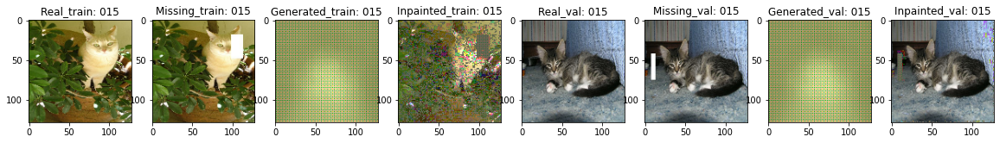

88/88 [==============================] - 26s 295ms/step - loss_generator: 33989.4453 - loss_discriminator: 1.4307 - total_loss: 33955.4648 - val_loss_generator: 19222.1641 - val_loss_discriminator: 1.4279 - val_total_loss: 19202.9395
Epoch 17/5000
89/88 [==============================] - ETA: 0s - loss_generator: 34355.4336 - loss_discriminator: 1.4253 - total_loss: 34321.0820

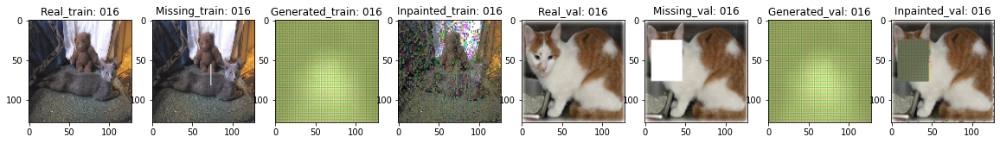

88/88 [==============================] - 26s 301ms/step - loss_generator: 34355.4336 - loss_discriminator: 1.4253 - total_loss: 34321.0820 - val_loss_generator: 18736.4707 - val_loss_discriminator: 1.4227 - val_total_loss: 18717.7344
Epoch 18/5000
89/88 [==============================] - ETA: 0s - loss_generator: 33331.5039 - loss_discriminator: 1.4204 - total_loss: 33298.1758

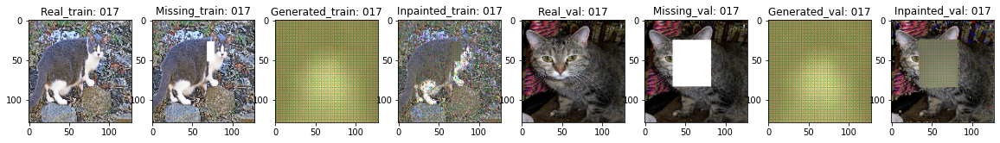

88/88 [==============================] - 32s 361ms/step - loss_generator: 33331.5039 - loss_discriminator: 1.4204 - total_loss: 33298.1758 - val_loss_generator: 18685.5059 - val_loss_discriminator: 1.4181 - val_total_loss: 18666.8223
Epoch 19/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29507.7324 - loss_discriminator: 1.4161 - total_loss: 29478.2305

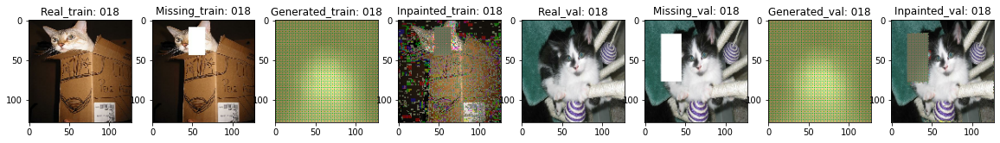

88/88 [==============================] - 27s 306ms/step - loss_generator: 29507.7324 - loss_discriminator: 1.4161 - total_loss: 29478.2305 - val_loss_generator: 18173.1445 - val_loss_discriminator: 1.4140 - val_total_loss: 18154.9746
Epoch 20/5000
89/88 [==============================] - ETA: 0s - loss_generator: 33464.1953 - loss_discriminator: 1.4121 - total_loss: 33430.7344

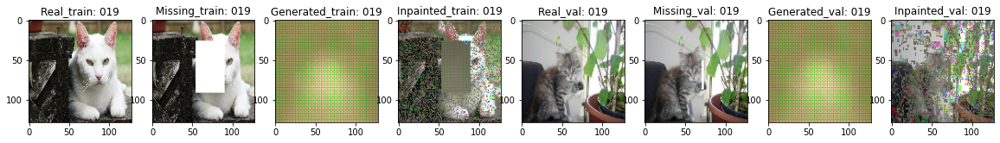

88/88 [==============================] - 32s 361ms/step - loss_generator: 33464.1953 - loss_discriminator: 1.4121 - total_loss: 33430.7344 - val_loss_generator: 18505.5977 - val_loss_discriminator: 1.4103 - val_total_loss: 18487.0918
Epoch 21/5000
89/88 [==============================] - ETA: 0s - loss_generator: 32764.8066 - loss_discriminator: 1.4086 - total_loss: 32732.0430

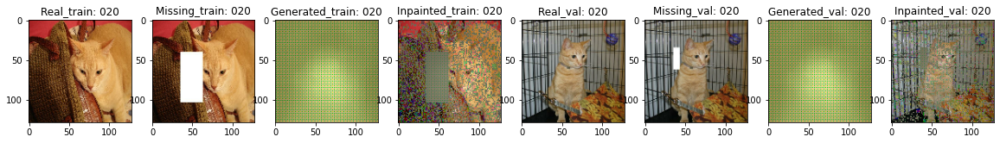

88/88 [==============================] - 26s 301ms/step - loss_generator: 32764.8066 - loss_discriminator: 1.4086 - total_loss: 32732.0430 - val_loss_generator: 17977.4277 - val_loss_discriminator: 1.4070 - val_total_loss: 17959.4531
Epoch 22/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30895.3711 - loss_discriminator: 1.4055 - total_loss: 30864.4824

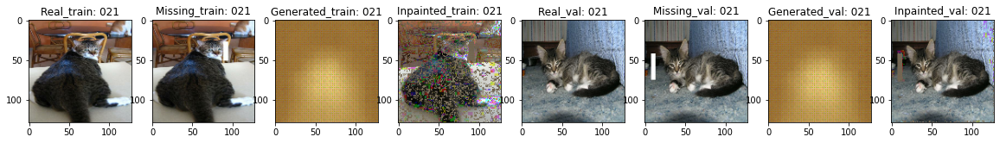

88/88 [==============================] - 32s 362ms/step - loss_generator: 30895.3711 - loss_discriminator: 1.4055 - total_loss: 30864.4824 - val_loss_generator: 17050.9570 - val_loss_discriminator: 1.4041 - val_total_loss: 17033.9062
Epoch 23/5000
89/88 [==============================] - ETA: 0s - loss_generator: 27252.0723 - loss_discriminator: 1.4028 - total_loss: 27224.8203

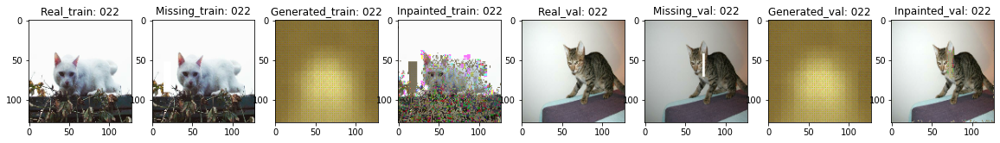

88/88 [==============================] - 26s 301ms/step - loss_generator: 27252.0723 - loss_discriminator: 1.4028 - total_loss: 27224.8203 - val_loss_generator: 16652.1426 - val_loss_discriminator: 1.4015 - val_total_loss: 16635.4941
Epoch 24/5000
89/88 [==============================] - ETA: 0s - loss_generator: 31650.8145 - loss_discriminator: 1.4003 - total_loss: 31619.1602

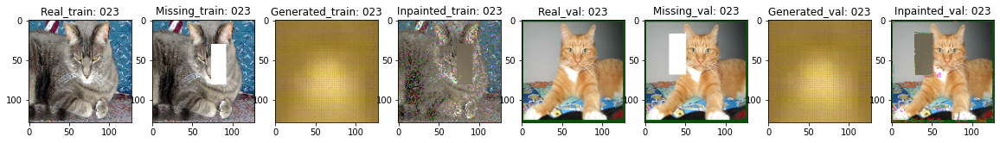

88/88 [==============================] - 31s 359ms/step - loss_generator: 31650.8145 - loss_discriminator: 1.4003 - total_loss: 31619.1602 - val_loss_generator: 17086.1074 - val_loss_discriminator: 1.3992 - val_total_loss: 17069.0234
Epoch 25/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30344.5625 - loss_discriminator: 1.3982 - total_loss: 30314.2168

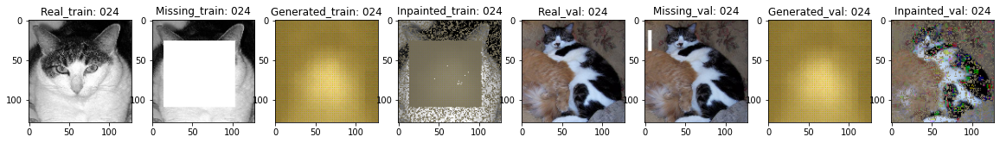

88/88 [==============================] - 27s 304ms/step - loss_generator: 30344.5625 - loss_discriminator: 1.3982 - total_loss: 30314.2168 - val_loss_generator: 16656.4434 - val_loss_discriminator: 1.3972 - val_total_loss: 16639.7871
Epoch 26/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29944.8418 - loss_discriminator: 1.3963 - total_loss: 29914.8965

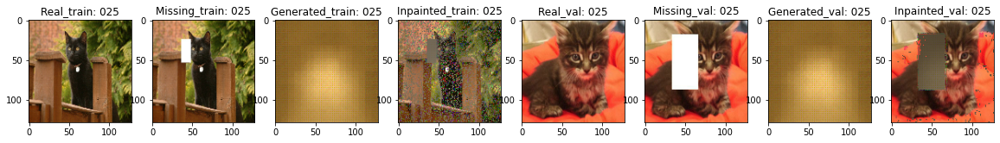

88/88 [==============================] - 31s 360ms/step - loss_generator: 29944.8418 - loss_discriminator: 1.3963 - total_loss: 29914.8965 - val_loss_generator: 16721.6191 - val_loss_discriminator: 1.3955 - val_total_loss: 16704.8965
Epoch 27/5000
89/88 [==============================] - ETA: 0s - loss_generator: 27460.8672 - loss_discriminator: 1.3947 - total_loss: 27433.4102

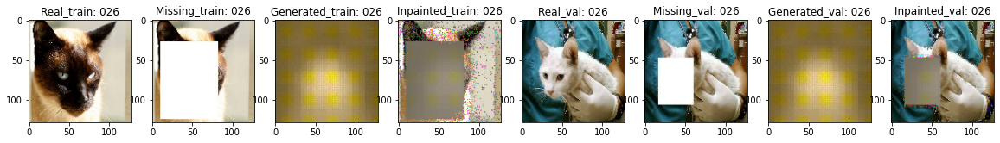

88/88 [==============================] - 26s 298ms/step - loss_generator: 27460.8672 - loss_discriminator: 1.3947 - total_loss: 27433.4102 - val_loss_generator: 16431.3281 - val_loss_discriminator: 1.3939 - val_total_loss: 16414.8984
Epoch 28/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30991.2617 - loss_discriminator: 1.3933 - total_loss: 30960.2617

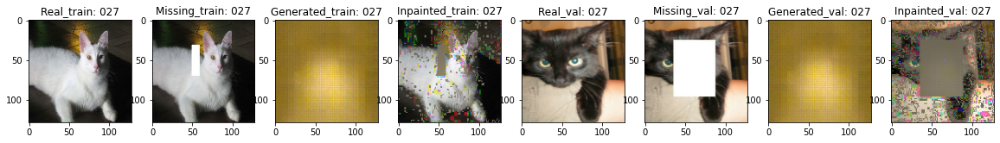

88/88 [==============================] - 27s 308ms/step - loss_generator: 30991.2617 - loss_discriminator: 1.3933 - total_loss: 30960.2617 - val_loss_generator: 16895.2266 - val_loss_discriminator: 1.3926 - val_total_loss: 16878.3340
Epoch 29/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30542.9551 - loss_discriminator: 1.3921 - total_loss: 30512.4238

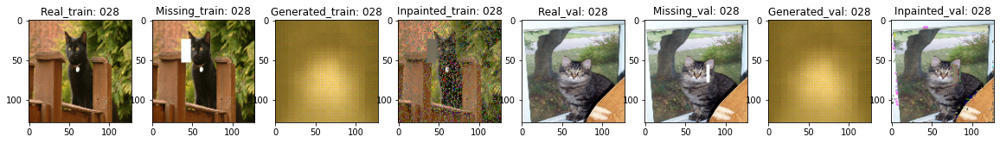

88/88 [==============================] - 27s 311ms/step - loss_generator: 30542.9551 - loss_discriminator: 1.3921 - total_loss: 30512.4238 - val_loss_generator: 16399.2051 - val_loss_discriminator: 1.3915 - val_total_loss: 16382.8135
Epoch 30/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29220.6133 - loss_discriminator: 1.3910 - total_loss: 29191.3867

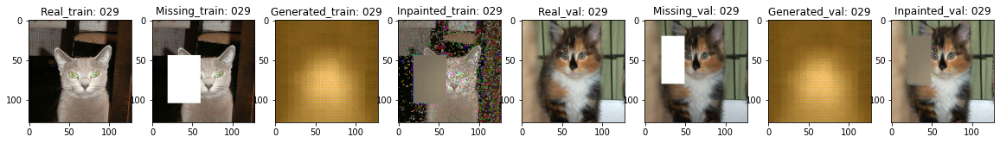

88/88 [==============================] - 26s 302ms/step - loss_generator: 29220.6133 - loss_discriminator: 1.3910 - total_loss: 29191.3867 - val_loss_generator: 16493.4082 - val_loss_discriminator: 1.3905 - val_total_loss: 16476.9141
Epoch 31/5000
89/88 [==============================] - ETA: 0s - loss_generator: 28182.5918 - loss_discriminator: 1.3901 - total_loss: 28154.4082

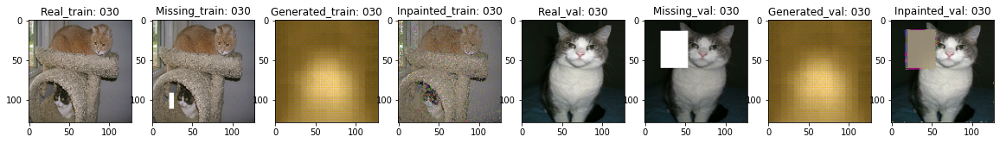

88/88 [==============================] - 32s 365ms/step - loss_generator: 28182.5918 - loss_discriminator: 1.3901 - total_loss: 28154.4082 - val_loss_generator: 16267.2695 - val_loss_discriminator: 1.3897 - val_total_loss: 16251.0039
Epoch 32/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30560.4863 - loss_discriminator: 1.3894 - total_loss: 30529.9316

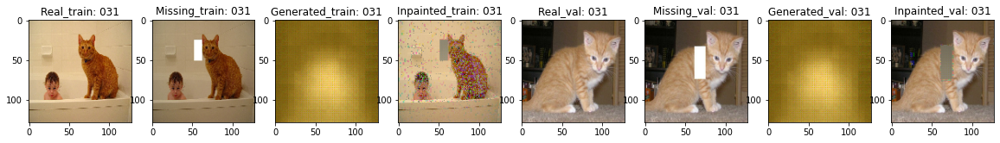

88/88 [==============================] - 31s 359ms/step - loss_generator: 30560.4863 - loss_discriminator: 1.3894 - total_loss: 30529.9316 - val_loss_generator: 16664.7207 - val_loss_discriminator: 1.3891 - val_total_loss: 16648.0586
Epoch 33/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30639.6816 - loss_discriminator: 1.3888 - total_loss: 30609.0430

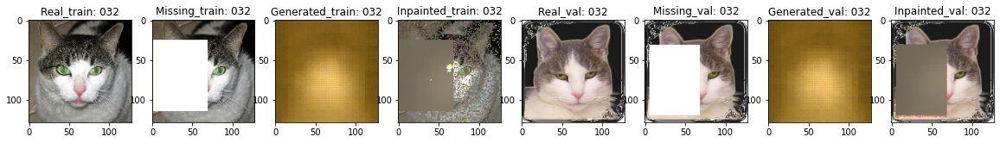

88/88 [==============================] - 26s 302ms/step - loss_generator: 30639.6816 - loss_discriminator: 1.3888 - total_loss: 30609.0430 - val_loss_generator: 16390.0684 - val_loss_discriminator: 1.3885 - val_total_loss: 16373.6855
Epoch 34/5000
89/88 [==============================] - ETA: 0s - loss_generator: 28393.1934 - loss_discriminator: 1.3883 - total_loss: 28364.7949

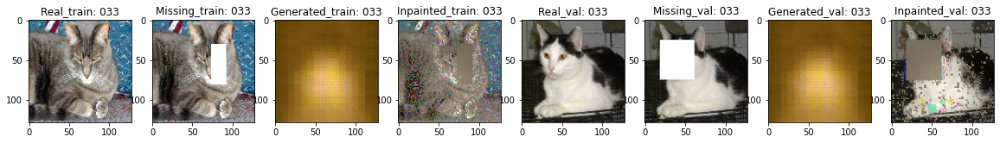

88/88 [==============================] - 26s 302ms/step - loss_generator: 28393.1934 - loss_discriminator: 1.3883 - total_loss: 28364.7949 - val_loss_generator: 16360.7490 - val_loss_discriminator: 1.3880 - val_total_loss: 16344.3887
Epoch 35/5000
89/88 [==============================] - ETA: 0s - loss_generator: 28802.4805 - loss_discriminator: 1.3878 - total_loss: 28773.6797

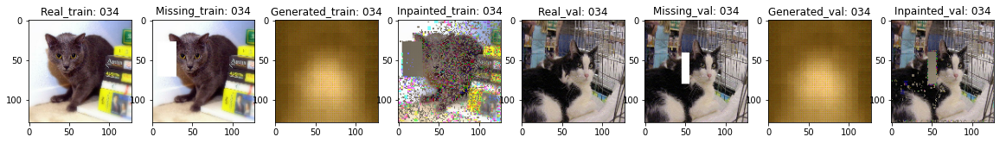

88/88 [==============================] - 32s 365ms/step - loss_generator: 28802.4805 - loss_discriminator: 1.3878 - total_loss: 28773.6797 - val_loss_generator: 16253.2305 - val_loss_discriminator: 1.3876 - val_total_loss: 16236.9805
Epoch 36/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30445.1660 - loss_discriminator: 1.3875 - total_loss: 30414.7305

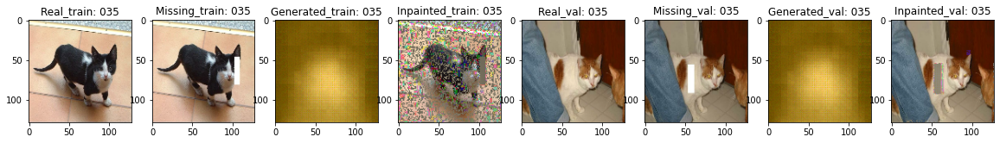

88/88 [==============================] - 32s 361ms/step - loss_generator: 30445.1660 - loss_discriminator: 1.3875 - total_loss: 30414.7305 - val_loss_generator: 16593.4883 - val_loss_discriminator: 1.3873 - val_total_loss: 16576.8945
Epoch 37/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30642.0840 - loss_discriminator: 1.3872 - total_loss: 30611.4355

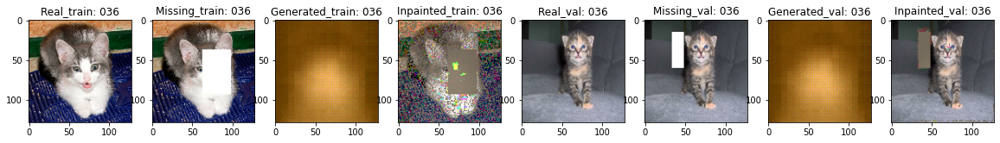

88/88 [==============================] - 31s 358ms/step - loss_generator: 30642.0840 - loss_discriminator: 1.3872 - total_loss: 30611.4355 - val_loss_generator: 16393.4219 - val_loss_discriminator: 1.3871 - val_total_loss: 16377.0283
Epoch 38/5000
89/88 [==============================] - ETA: 0s - loss_generator: 27479.3223 - loss_discriminator: 1.3870 - total_loss: 27451.8418

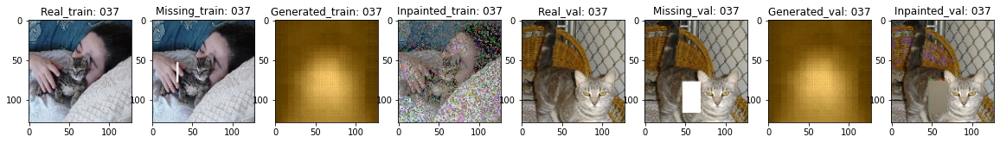

88/88 [==============================] - 26s 293ms/step - loss_generator: 27479.3223 - loss_discriminator: 1.3870 - total_loss: 27451.8418 - val_loss_generator: 16263.5703 - val_loss_discriminator: 1.3869 - val_total_loss: 16247.3037
Epoch 39/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29567.8516 - loss_discriminator: 1.3868 - total_loss: 29538.2734

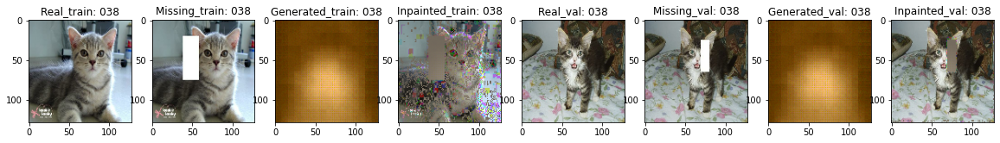

88/88 [==============================] - 31s 357ms/step - loss_generator: 29567.8516 - loss_discriminator: 1.3868 - total_loss: 29538.2734 - val_loss_generator: 16346.5732 - val_loss_discriminator: 1.3867 - val_total_loss: 16330.2334
Epoch 40/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30459.9551 - loss_discriminator: 1.3867 - total_loss: 30429.4941

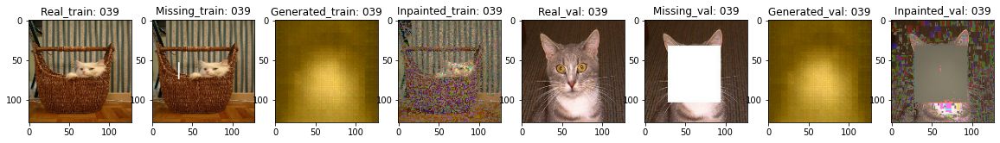

88/88 [==============================] - 32s 363ms/step - loss_generator: 30459.9551 - loss_discriminator: 1.3867 - total_loss: 30429.4941 - val_loss_generator: 16469.8125 - val_loss_discriminator: 1.3866 - val_total_loss: 16453.3496
Epoch 41/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30431.7305 - loss_discriminator: 1.3866 - total_loss: 30401.3027

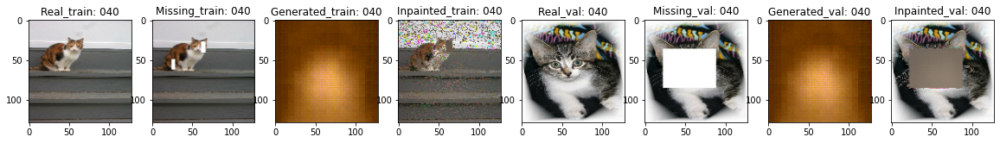

88/88 [==============================] - 27s 304ms/step - loss_generator: 30431.7305 - loss_discriminator: 1.3866 - total_loss: 30401.3027 - val_loss_generator: 16404.5996 - val_loss_discriminator: 1.3865 - val_total_loss: 16388.1953
Epoch 42/5000
89/88 [==============================] - ETA: 0s - loss_generator: 26813.6523 - loss_discriminator: 1.3865 - total_loss: 26786.8398

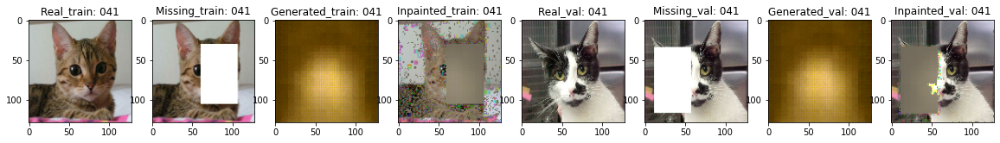

88/88 [==============================] - 32s 361ms/step - loss_generator: 26813.6523 - loss_discriminator: 1.3865 - total_loss: 26786.8398 - val_loss_generator: 16192.5742 - val_loss_discriminator: 1.3865 - val_total_loss: 16176.3887
Epoch 43/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30267.9219 - loss_discriminator: 1.3864 - total_loss: 30237.6484

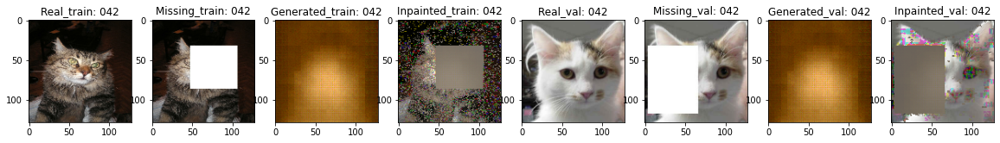

88/88 [==============================] - 26s 301ms/step - loss_generator: 30267.9219 - loss_discriminator: 1.3864 - total_loss: 30237.6484 - val_loss_generator: 16532.5918 - val_loss_discriminator: 1.3864 - val_total_loss: 16516.0547
Epoch 44/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30464.0820 - loss_discriminator: 1.3864 - total_loss: 30433.6270

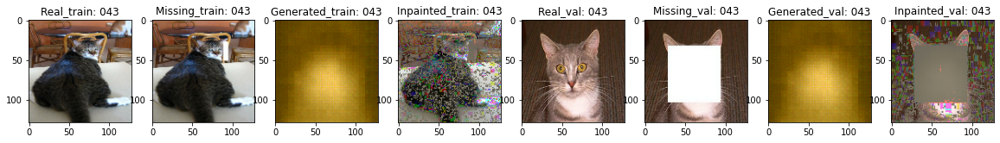

88/88 [==============================] - 27s 307ms/step - loss_generator: 30464.0820 - loss_discriminator: 1.3864 - total_loss: 30433.6270 - val_loss_generator: 16377.7568 - val_loss_discriminator: 1.3864 - val_total_loss: 16361.3779
Epoch 45/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29872.9570 - loss_discriminator: 1.3864 - total_loss: 29843.0840

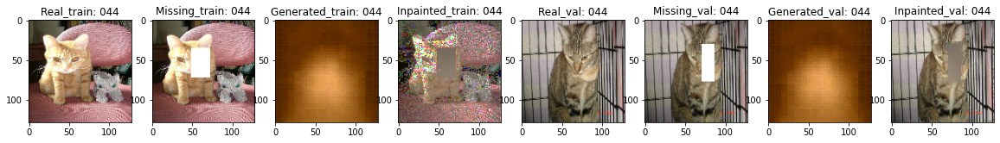

88/88 [==============================] - 31s 358ms/step - loss_generator: 29872.9570 - loss_discriminator: 1.3864 - total_loss: 29843.0840 - val_loss_generator: 16407.9473 - val_loss_discriminator: 1.3864 - val_total_loss: 16391.5449
Epoch 46/5000
89/88 [==============================] - ETA: 0s - loss_generator: 26619.3066 - loss_discriminator: 1.3863 - total_loss: 26592.6973

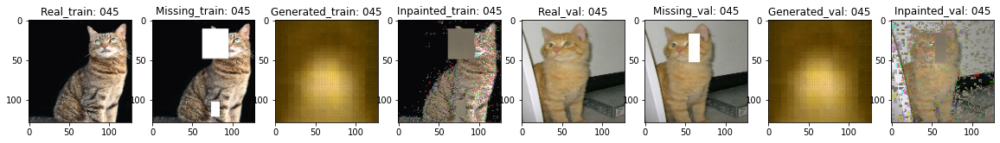

88/88 [==============================] - 31s 359ms/step - loss_generator: 26619.3066 - loss_discriminator: 1.3863 - total_loss: 26592.6973 - val_loss_generator: 16194.3457 - val_loss_discriminator: 1.3863 - val_total_loss: 16178.1543
Epoch 47/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30939.6152 - loss_discriminator: 1.3863 - total_loss: 30908.6855

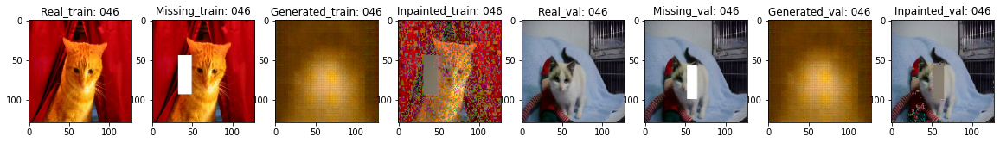

88/88 [==============================] - 27s 305ms/step - loss_generator: 30939.6152 - loss_discriminator: 1.3863 - total_loss: 30908.6855 - val_loss_generator: 16583.3359 - val_loss_discriminator: 1.3863 - val_total_loss: 16566.7578
Epoch 48/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30040.3066 - loss_discriminator: 1.3863 - total_loss: 30010.2676

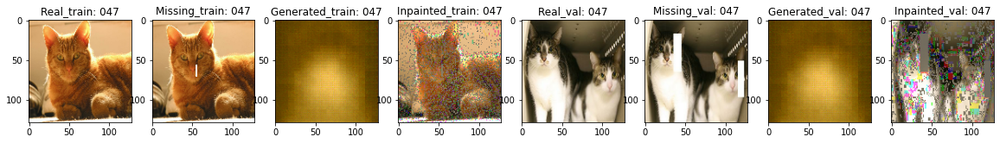

88/88 [==============================] - 27s 309ms/step - loss_generator: 30040.3066 - loss_discriminator: 1.3863 - total_loss: 30010.2676 - val_loss_generator: 16372.1191 - val_loss_discriminator: 1.3863 - val_total_loss: 16355.7441
Epoch 49/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29710.3906 - loss_discriminator: 1.3863 - total_loss: 29680.6855

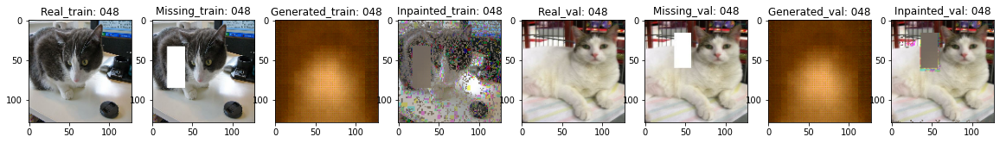

88/88 [==============================] - 27s 303ms/step - loss_generator: 29710.3906 - loss_discriminator: 1.3863 - total_loss: 29680.6855 - val_loss_generator: 16400.3867 - val_loss_discriminator: 1.3863 - val_total_loss: 16383.9834
Epoch 50/5000
89/88 [==============================] - ETA: 0s - loss_generator: 26659.3418 - loss_discriminator: 1.3863 - total_loss: 26632.6855

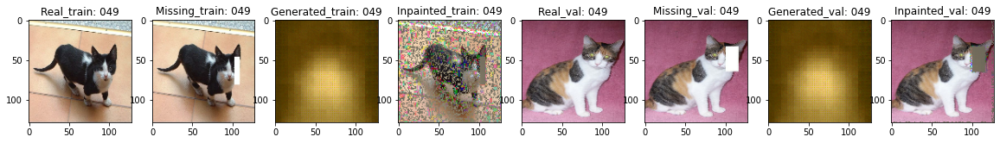

88/88 [==============================] - 27s 304ms/step - loss_generator: 26659.3418 - loss_discriminator: 1.3863 - total_loss: 26632.6855 - val_loss_generator: 16105.0322 - val_loss_discriminator: 1.3863 - val_total_loss: 16088.9268
Epoch 51/5000
89/88 [==============================] - ETA: 0s - loss_generator: 31073.0234 - loss_discriminator: 1.3863 - total_loss: 31041.9414

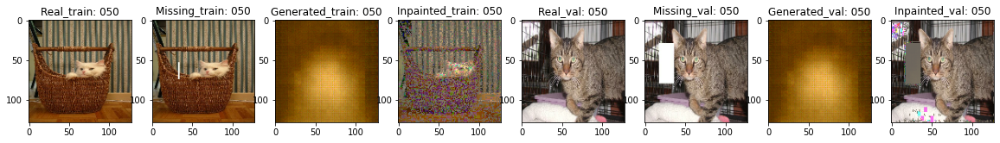

88/88 [==============================] - 31s 357ms/step - loss_generator: 31073.0234 - loss_discriminator: 1.3863 - total_loss: 31041.9414 - val_loss_generator: 16632.5762 - val_loss_discriminator: 1.3863 - val_total_loss: 16615.9414
Epoch 52/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30033.4805 - loss_discriminator: 1.3863 - total_loss: 30003.4434

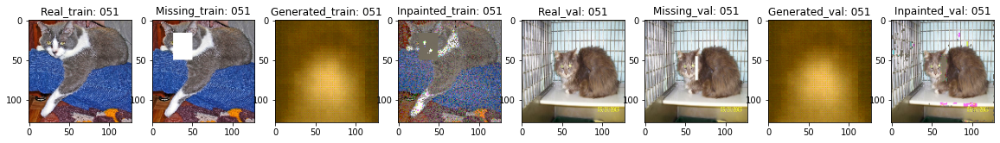

88/88 [==============================] - 27s 306ms/step - loss_generator: 30033.4805 - loss_discriminator: 1.3863 - total_loss: 30003.4434 - val_loss_generator: 16303.5088 - val_loss_discriminator: 1.3863 - val_total_loss: 16287.2021
Epoch 53/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29393.1152 - loss_discriminator: 1.3863 - total_loss: 29363.7246

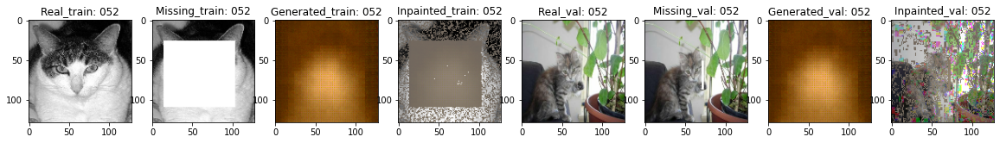

88/88 [==============================] - 31s 359ms/step - loss_generator: 29393.1152 - loss_discriminator: 1.3863 - total_loss: 29363.7246 - val_loss_generator: 16316.7314 - val_loss_discriminator: 1.3863 - val_total_loss: 16300.4170
Epoch 54/5000
89/88 [==============================] - ETA: 0s - loss_generator: 27479.2578 - loss_discriminator: 1.3863 - total_loss: 27451.7676

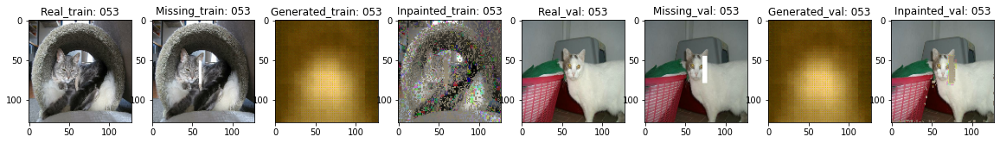

88/88 [==============================] - 26s 300ms/step - loss_generator: 27479.2578 - loss_discriminator: 1.3863 - total_loss: 27451.7676 - val_loss_generator: 16139.9932 - val_loss_discriminator: 1.3863 - val_total_loss: 16123.8525
Epoch 55/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30584.1465 - loss_discriminator: 1.3863 - total_loss: 30553.5625

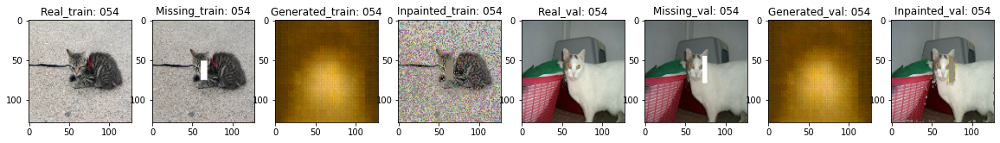

88/88 [==============================] - 27s 308ms/step - loss_generator: 30584.1465 - loss_discriminator: 1.3863 - total_loss: 30553.5625 - val_loss_generator: 16517.4570 - val_loss_discriminator: 1.3863 - val_total_loss: 16500.9395
Epoch 56/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30474.5645 - loss_discriminator: 1.3863 - total_loss: 30444.0918

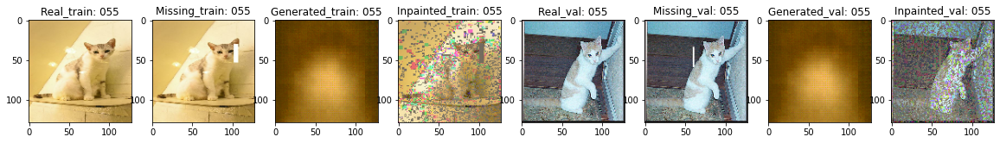

88/88 [==============================] - 26s 302ms/step - loss_generator: 30474.5645 - loss_discriminator: 1.3863 - total_loss: 30444.0918 - val_loss_generator: 16325.9463 - val_loss_discriminator: 1.3863 - val_total_loss: 16309.6240
Epoch 57/5000
89/88 [==============================] - ETA: 0s - loss_generator: 28700.8223 - loss_discriminator: 1.3863 - total_loss: 28672.1211

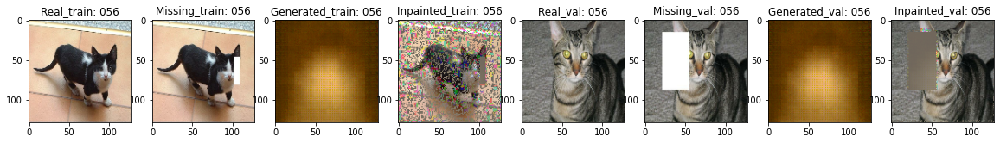

88/88 [==============================] - 32s 361ms/step - loss_generator: 28700.8223 - loss_discriminator: 1.3863 - total_loss: 28672.1211 - val_loss_generator: 16288.1670 - val_loss_discriminator: 1.3863 - val_total_loss: 16271.8760
Epoch 58/5000
89/88 [==============================] - ETA: 0s - loss_generator: 28302.0137 - loss_discriminator: 1.3863 - total_loss: 28273.7031

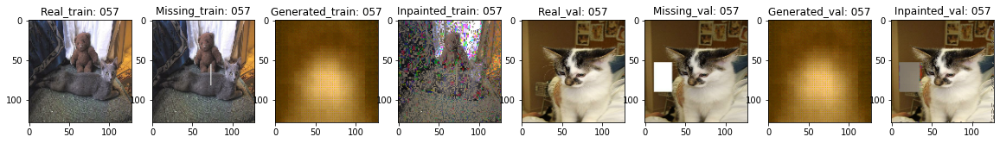

88/88 [==============================] - 31s 359ms/step - loss_generator: 28302.0137 - loss_discriminator: 1.3863 - total_loss: 28273.7031 - val_loss_generator: 16166.9160 - val_loss_discriminator: 1.3863 - val_total_loss: 16150.7500
Epoch 59/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30427.1621 - loss_discriminator: 1.3863 - total_loss: 30396.7500

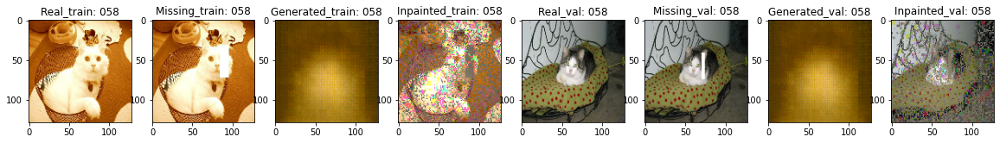

88/88 [==============================] - 27s 311ms/step - loss_generator: 30427.1621 - loss_discriminator: 1.3863 - total_loss: 30396.7500 - val_loss_generator: 16534.3730 - val_loss_discriminator: 1.3863 - val_total_loss: 16517.8359
Epoch 60/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30501.4766 - loss_discriminator: 1.3863 - total_loss: 30470.9805

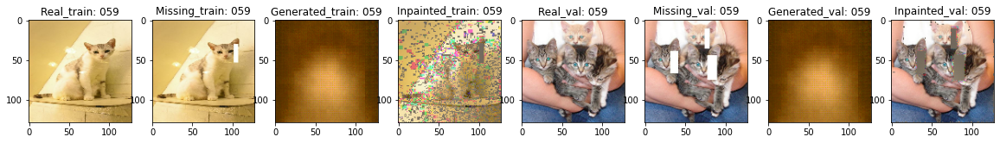

88/88 [==============================] - 27s 311ms/step - loss_generator: 30501.4766 - loss_discriminator: 1.3863 - total_loss: 30470.9805 - val_loss_generator: 16329.9902 - val_loss_discriminator: 1.3863 - val_total_loss: 16313.6631
Epoch 61/5000
89/88 [==============================] - ETA: 0s - loss_generator: 27957.4160 - loss_discriminator: 1.3863 - total_loss: 27929.4531

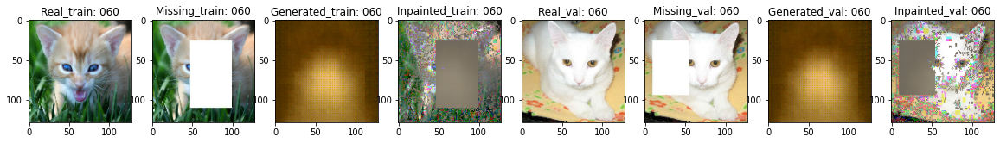

88/88 [==============================] - 27s 307ms/step - loss_generator: 27957.4160 - loss_discriminator: 1.3863 - total_loss: 27929.4531 - val_loss_generator: 16239.5830 - val_loss_discriminator: 1.3863 - val_total_loss: 16223.3457
Epoch 62/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29035.8828 - loss_discriminator: 1.3863 - total_loss: 29006.8320

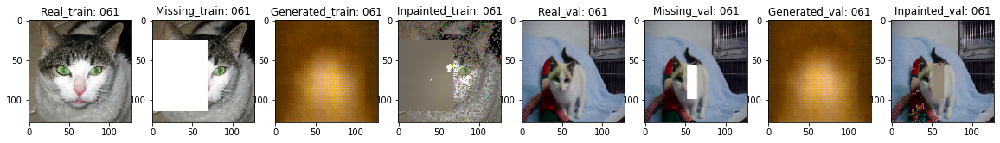

88/88 [==============================] - 27s 305ms/step - loss_generator: 29035.8828 - loss_discriminator: 1.3863 - total_loss: 29006.8320 - val_loss_generator: 16215.6260 - val_loss_discriminator: 1.3863 - val_total_loss: 16199.4141
Epoch 63/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30371.5957 - loss_discriminator: 1.3863 - total_loss: 30341.2188

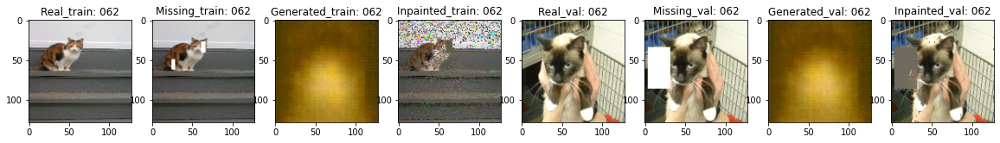

88/88 [==============================] - 27s 310ms/step - loss_generator: 30371.5957 - loss_discriminator: 1.3863 - total_loss: 30341.2188 - val_loss_generator: 16476.6680 - val_loss_discriminator: 1.3863 - val_total_loss: 16460.1914
Epoch 64/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30618.6777 - loss_discriminator: 1.3863 - total_loss: 30588.0527

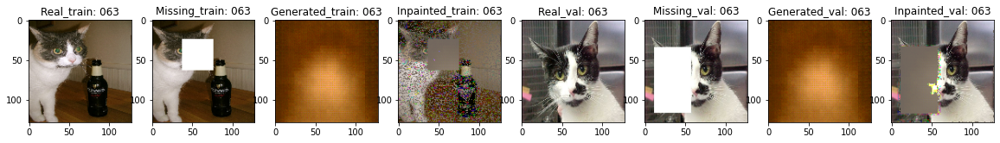

88/88 [==============================] - 31s 360ms/step - loss_generator: 30618.6777 - loss_discriminator: 1.3863 - total_loss: 30588.0527 - val_loss_generator: 16372.4873 - val_loss_discriminator: 1.3863 - val_total_loss: 16356.1191
Epoch 65/5000
89/88 [==============================] - ETA: 0s - loss_generator: 27095.1660 - loss_discriminator: 1.3863 - total_loss: 27068.0723

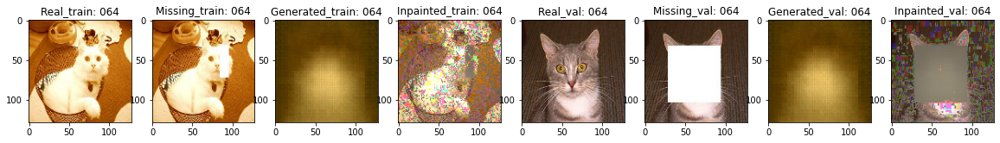

88/88 [==============================] - 27s 308ms/step - loss_generator: 27095.1660 - loss_discriminator: 1.3863 - total_loss: 27068.0723 - val_loss_generator: 16200.2285 - val_loss_discriminator: 1.3863 - val_total_loss: 16184.0283
Epoch 66/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29854.7832 - loss_discriminator: 1.3863 - total_loss: 29824.9355

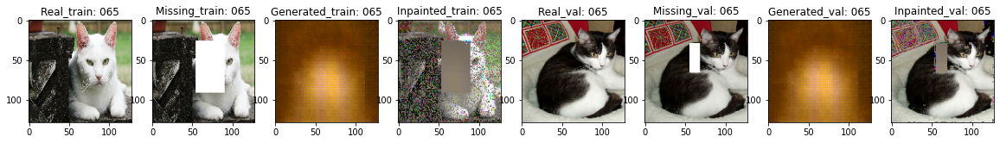

88/88 [==============================] - 31s 357ms/step - loss_generator: 29854.7832 - loss_discriminator: 1.3863 - total_loss: 29824.9355 - val_loss_generator: 16343.9912 - val_loss_discriminator: 1.3863 - val_total_loss: 16327.6514
Epoch 67/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30526.0879 - loss_discriminator: 1.3863 - total_loss: 30495.5645

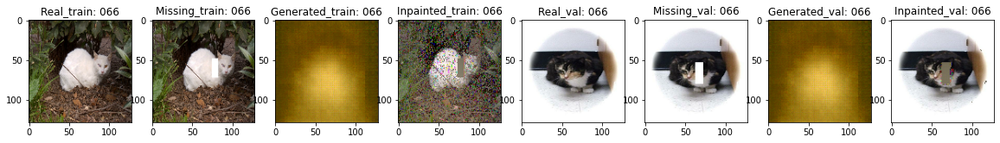

88/88 [==============================] - 27s 314ms/step - loss_generator: 30526.0879 - loss_discriminator: 1.3863 - total_loss: 30495.5645 - val_loss_generator: 16403.2461 - val_loss_discriminator: 1.3863 - val_total_loss: 16386.8418
Epoch 68/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30135.2129 - loss_discriminator: 1.3863 - total_loss: 30105.0840

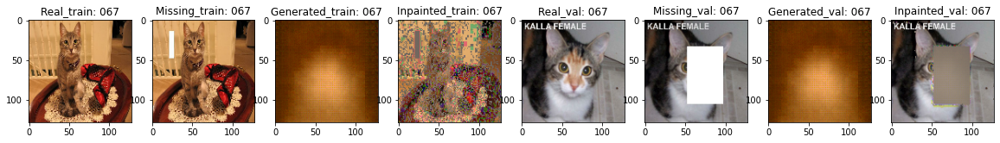

88/88 [==============================] - 27s 312ms/step - loss_generator: 30135.2129 - loss_discriminator: 1.3863 - total_loss: 30105.0840 - val_loss_generator: 16408.6621 - val_loss_discriminator: 1.3863 - val_total_loss: 16392.2578
Epoch 69/5000
89/88 [==============================] - ETA: 0s - loss_generator: 26669.5254 - loss_discriminator: 1.3863 - total_loss: 26642.8516

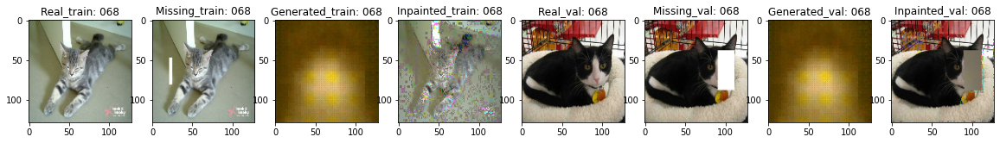

88/88 [==============================] - 27s 307ms/step - loss_generator: 26669.5254 - loss_discriminator: 1.3863 - total_loss: 26642.8516 - val_loss_generator: 16126.5361 - val_loss_discriminator: 1.3863 - val_total_loss: 16110.4131
Epoch 70/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30613.0312 - loss_discriminator: 1.3863 - total_loss: 30582.4297

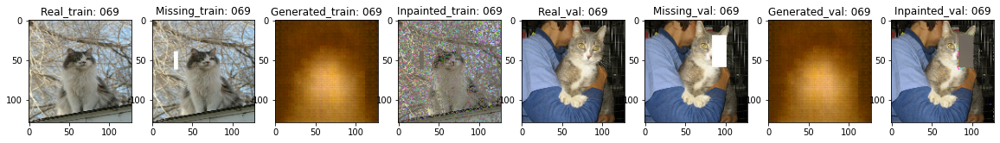

88/88 [==============================] - 27s 311ms/step - loss_generator: 30613.0312 - loss_discriminator: 1.3863 - total_loss: 30582.4297 - val_loss_generator: 16486.4453 - val_loss_discriminator: 1.3863 - val_total_loss: 16469.9609
Epoch 71/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30291.6973 - loss_discriminator: 1.3863 - total_loss: 30261.4180

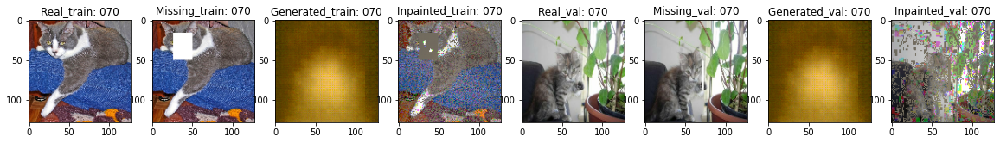

88/88 [==============================] - 31s 357ms/step - loss_generator: 30291.6973 - loss_discriminator: 1.3863 - total_loss: 30261.4180 - val_loss_generator: 16382.1240 - val_loss_discriminator: 1.3863 - val_total_loss: 16365.7383
Epoch 72/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29750.5703 - loss_discriminator: 1.3863 - total_loss: 29720.8203

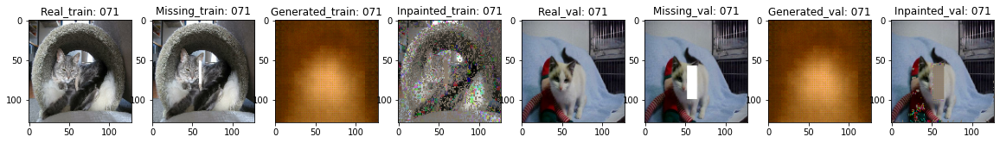

88/88 [==============================] - 31s 357ms/step - loss_generator: 29750.5703 - loss_discriminator: 1.3863 - total_loss: 29720.8203 - val_loss_generator: 16343.4912 - val_loss_discriminator: 1.3863 - val_total_loss: 16327.1514
Epoch 73/5000
89/88 [==============================] - ETA: 0s - loss_generator: 26575.4766 - loss_discriminator: 1.3863 - total_loss: 26548.8926

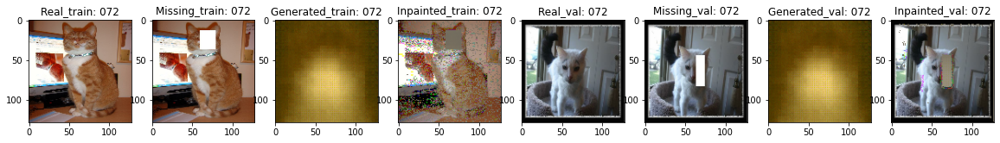

88/88 [==============================] - 27s 305ms/step - loss_generator: 26575.4766 - loss_discriminator: 1.3863 - total_loss: 26548.8926 - val_loss_generator: 16147.4258 - val_loss_discriminator: 1.3863 - val_total_loss: 16131.2852
Epoch 74/5000
89/88 [==============================] - ETA: 0s - loss_generator: 31012.0273 - loss_discriminator: 1.3863 - total_loss: 30981.0273

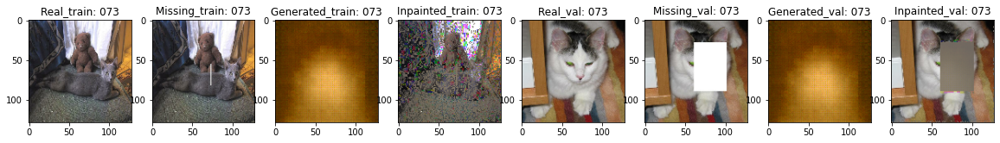

88/88 [==============================] - 27s 313ms/step - loss_generator: 31012.0273 - loss_discriminator: 1.3863 - total_loss: 30981.0273 - val_loss_generator: 16500.0254 - val_loss_discriminator: 1.3863 - val_total_loss: 16483.5273
Epoch 75/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29943.3789 - loss_discriminator: 1.3863 - total_loss: 29913.4473

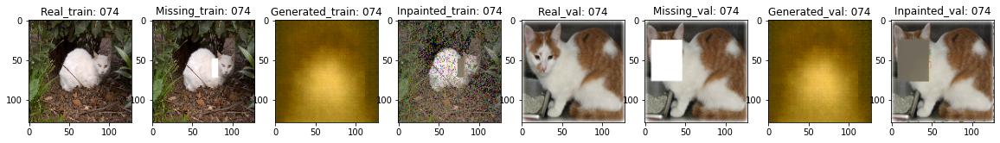

88/88 [==============================] - 31s 358ms/step - loss_generator: 29943.3789 - loss_discriminator: 1.3863 - total_loss: 29913.4473 - val_loss_generator: 16369.8389 - val_loss_discriminator: 1.3863 - val_total_loss: 16353.4775
Epoch 76/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29607.5020 - loss_discriminator: 1.3863 - total_loss: 29577.8867

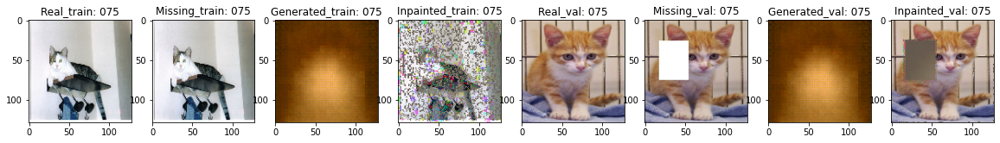

88/88 [==============================] - 27s 307ms/step - loss_generator: 29607.5020 - loss_discriminator: 1.3863 - total_loss: 29577.8867 - val_loss_generator: 16359.0215 - val_loss_discriminator: 1.3863 - val_total_loss: 16342.6611
Epoch 77/5000
89/88 [==============================] - ETA: 0s - loss_generator: 27015.8262 - loss_discriminator: 1.3863 - total_loss: 26988.8145

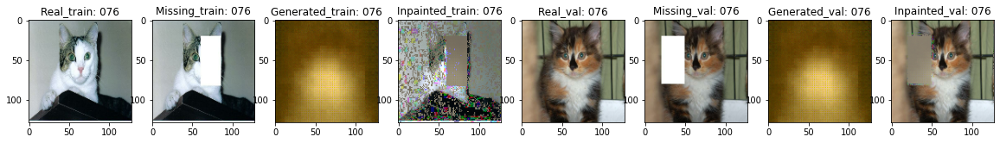

88/88 [==============================] - 27s 307ms/step - loss_generator: 27015.8262 - loss_discriminator: 1.3863 - total_loss: 26988.8145 - val_loss_generator: 16136.2041 - val_loss_discriminator: 1.3863 - val_total_loss: 16120.0664
Epoch 78/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30840.6133 - loss_discriminator: 1.3863 - total_loss: 30809.7637

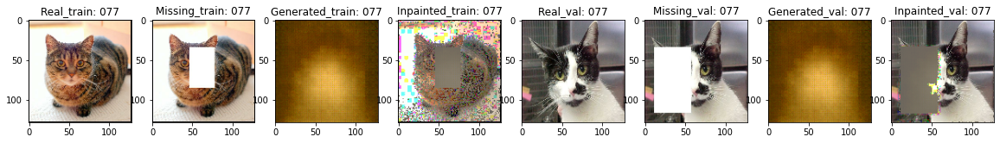

88/88 [==============================] - 27s 312ms/step - loss_generator: 30840.6133 - loss_discriminator: 1.3863 - total_loss: 30809.7637 - val_loss_generator: 16464.2168 - val_loss_discriminator: 1.3863 - val_total_loss: 16447.7480
Epoch 79/5000
89/88 [==============================] - ETA: 0s - loss_generator: 30177.7227 - loss_discriminator: 1.3863 - total_loss: 30147.5508

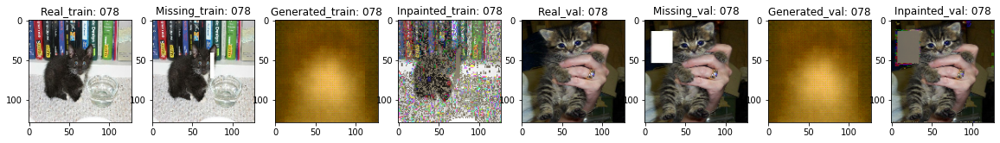

88/88 [==============================] - 31s 357ms/step - loss_generator: 30177.7227 - loss_discriminator: 1.3863 - total_loss: 30147.5508 - val_loss_generator: 16287.2217 - val_loss_discriminator: 1.3863 - val_total_loss: 16270.9336
Epoch 80/5000
89/88 [==============================] - ETA: 0s - loss_generator: 29110.9883 - loss_discriminator: 1.3863 - total_loss: 29081.8867

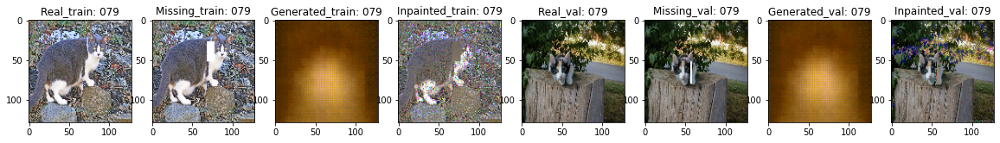

88/88 [==============================] - 27s 312ms/step - loss_generator: 29110.9883 - loss_discriminator: 1.3863 - total_loss: 29081.8867 - val_loss_generator: 16316.8779 - val_loss_discriminator: 1.3863 - val_total_loss: 16300.5605


In [ ]:
import datetime

optimizer = tf.keras.optimizers.Adam(2e-4)

discriminator = Discriminator()
generator = Generator()

model = ImageInpainting(generator=generator, discriminator=discriminator)
x = model(missing)

model.compile(optimizer = optimizer, loss_generator = generator_loss,discriminator_loss = discriminator_loss)


log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss_generator', patience=30,restore_best_weights=True)

history = model.fit(
    images_train, 
    epochs=5000,
    steps_per_epoch=5652/BATCH_SIZE,
    validation_data=images_val,
    validation_steps=5652/BATCH_SIZE,
    callbacks=[TrainMonitor(),tensorboard_callback,early_stopping],
)

In [ ]:
rm -rf ./logs/fit

**TensorBoard** 

this is the tensorboard we've talked about.

very useful 🌝

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

## **Metrics Visualization 📷**

observe the final results of the model

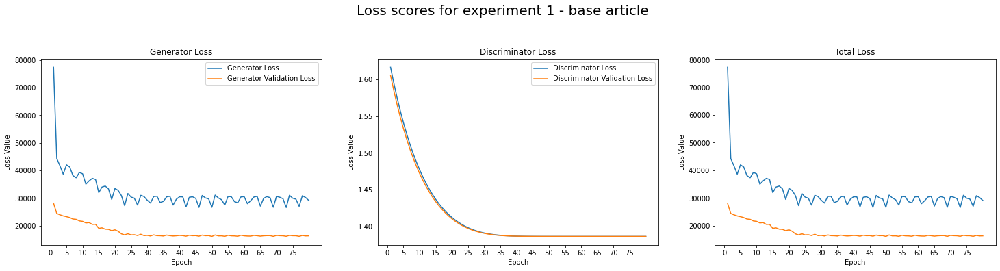

In [ ]:
import numpy as np

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(25,5))
t = f.suptitle('Loss scores for experiment 1 - base article', fontsize=20, y=1.1)


epoch_list = list(range(1,80+1))

ax1.plot(epoch_list, history.history['loss_generator'], label='Generator Loss')
ax1.plot(epoch_list, history.history['val_loss_generator'], label='Generator Validation Loss')
#ax2.plot(epoch_list, history.history['loss_discriminator'], label='Discriminator Loss')
#ax2.plot(epoch_list, history.history['total_loss'], label='Discriminator Loss')
ax1.set_xticks(np.arange(0, 80, 5))
ax1.set_ylabel('Loss Value')
ax1.set_xlabel('Epoch')
ax1.set_title('Generator Loss')
l1 = ax1.legend(loc="best")


#ax2.plot(epoch_list, history.history['loss_generator'], label='Generator Loss')
ax2.plot(epoch_list, history.history['loss_discriminator'], label='Discriminator Loss')
ax2.plot(epoch_list, history.history['val_loss_discriminator'], label='Discriminator Validation Loss')
#ax2.plot(epoch_list, history.history['total_loss'], label='Discriminator Loss')
ax2.set_xticks(np.arange(0, 80, 5))
ax2.set_ylabel('Loss Value')
ax2.set_xlabel('Epoch')
ax2.set_title('Discriminator Loss')
l2 = ax2.legend(loc="best")

#ax2.plot(epoch_list, history.history['loss_generator'], label='Generator Loss')
ax3.plot(epoch_list, history.history['total_loss'], label='Total Loss')
ax3.plot(epoch_list, history.history['val_total_loss'], label='Total Validation Loss')
#ax2.plot(epoch_list, history.history['total_loss'], label='Discriminator Loss')
ax3.set_xticks(np.arange(0, 80, 5))
ax3.set_ylabel('Loss Value')
ax3.set_xlabel('Epoch')
ax3.set_title('Total Loss')
l3 = ax2.legend(loc="best")

## **Model Evaluation 🖼**

evaluate the model with the test_set

In [ ]:
score = model.evaluate(images_test, steps=5652/BATCH_SIZE)

88/88 [==============================] - 34s 285ms/step - loss_generator: 15693.6699 - loss_discriminator: 1.3863 - total_loss: 15677.9785


# **Experiment number 4: (The chosen architecture) 🧪 🥇** 

the experiment is basted on PIX2PIX model.

further information ahead 😀

## **Model building and architecture 👷**

the architecture and the model building proccess is all based on the article:

['Image-to-Image Translation with Conditional Adversarial Networks'](https://arxiv.org/pdf/1611.07004.pdf) from Berkeley.

the article offer a model named "PIX2PIX" which it's goal is for image translation.

we changed a little bit the loss and other parameter for our problem.

just for first feeling what we're about to do here's the general and original of "PIX2PIX" architecture:

<a align="bottom left"  target="_blank">
<img width="500", src="https://blog.perceptilabs.com/content/images/2021/02/image-77.png"></a>

### **Generator 🧝**

The generator's architecture is based on "PIX2PIX" model which use on the U-Net model principles of upsampling and downsampling

In [12]:
#function for creating a downsample layer

def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [13]:
#function for creating a upsample layer
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [14]:
#The main function for creation a whole generator

def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
    downsample(512, 4),  # (batch_size, 2, 2, 512)
    downsample(512, 4),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
    upsample(512, 4),  # (batch_size, 16, 16, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
    upsample(128, 4),  # (batch_size, 64, 64, 256)
    upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(3, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

**Generator summary** 

showing generator summary to verify everything is Ok 👌
and also for our teacher to have a look on the details inside

In [15]:
generator = Generator()
generator.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 128, 128, 64  3072        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_1 (Sequential)      (None, 64, 64, 128)  131584      ['sequential[0][0]']             
                                                                                              

**Generator's Loss** 

we changed the Genrator's Loss to fit to our problem.
In practice we demand the loss to look only on the pixels of the missing part

In [16]:
def generator_loss(real,missing,gen_output,disc_generated_output):

  loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)
  
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  mask = tf.math.subtract(missing,real)
  real = tf.where(mask>0,real,0)
  gen_output = tf.where(mask>0,gen_output,0)
  subtracted = tf.math.subtract(real,gen_output)
  
  l2_loss = tf.nn.l2_loss(subtracted)
  total_loss = (l2_loss * 0.999) + (gan_loss * 0.001)
  
  
  return total_loss

### **Discriminator 🕵**

The discriminator's architecture is based on article.
accept we had to change the Input discriminator to get only one input and not two like "PIX2PIX" because we only want the discriminator to distinguish between the ground truth and the generated image

In [17]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  #inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  #tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  #x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(inp)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=inp, outputs=last)

In [18]:
#discriminator architecture
discriminator = Discriminator()
discriminator.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 256, 256, 3)]     0         
                                                                 
 sequential_15 (Sequential)  (None, 128, 128, 64)      3072      
                                                                 
 sequential_16 (Sequential)  (None, 64, 64, 128)       131584    
                                                                 
 sequential_17 (Sequential)  (None, 32, 32, 256)       525312    
                                                                 
 zero_padding2d (ZeroPadding  (None, 34, 34, 256)      0         
 2D)                                                             
                                                                 
 conv2d_11 (Conv2D)          (None, 31, 31, 512)       2097152   
                                                           

**Discriminator's Loss** 

the Discriminator's Loss is based on the article as is

In [19]:
def discriminator_loss(disc_real_output, disc_generated_output):

  loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss


### **The Model 🎨**

The Model is cointaining the relevent data for traning and also managing the training and evaluation part like in Keras.


We managed to do it by inherit "keras.Model" class and overide some of the neccessery methods which was neccessery to fit for our training proccess

In [20]:
#Our Model

class ImageInpainting(keras.Model):

  def __init__(self, generator, discriminator, **kwargs):
    super().__init__(**kwargs)
    self.generator = generator
    self.discriminator = discriminator
      
  #the ragular compile with a little change
  def compile(self, optimizer, loss_generator,discriminator_loss,**kwargs):

    super().compile(**kwargs)
    self.optimizer = optimizer
    self.loss_generator = loss_generator
    self.discriminator_loss = discriminator_loss
    self.generator_loss_tracker = keras.metrics.Mean(name="loss_generator")
    self.discriminator_loss_tracker = keras.metrics.Mean(name="loss_discriminator")
    
      
  #metrics to see results during training proccess
  @property
  def metrics(self):
    return [
    self.generator_loss_tracker,
    self.discriminator_loss_tracker]



  #our edited training step suitable for our proccess :)
  @tf.function()
  def train_step(self, data):
    #print(data)
    real, missing = data
    
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      gen_output = generator(missing, training=True)

      disc_real_output = discriminator(real, training=True)
      disc_generated_output = discriminator(gen_output, training=True)

      loss_generator = generator_loss(real,missing,gen_output,disc_generated_output)
      loss_discriminator = discriminator_loss(disc_real_output, disc_generated_output)
      
      generator_gradients = gen_tape.gradient(loss_generator,
                                            generator.trainable_variables)
      discriminator_gradients = disc_tape.gradient(loss_discriminator,
                                                discriminator.trainable_variables)

    self.optimizer.apply_gradients(zip(generator_gradients,
                                            generator.trainable_variables))
    self.optimizer.apply_gradients(zip(discriminator_gradients,
                                                discriminator.trainable_variables))

    self.generator_loss_tracker.update_state(loss_generator)
    self.discriminator_loss_tracker.update_state(loss_discriminator)
    

    results = {m.name: m.result() for m in self.metrics}
    return results

  #our edited validation step suitable for our proccess :)
  @tf.function()
  def test_step(self, data):

    
    real, missing = data
     
    self.discriminator.trainable = False
    self.generator.trainable = False

    gen_output = generator(missing, training=True)

    disc_real_output = discriminator(real, training=True)
    disc_generated_output = discriminator(gen_output, training=True)

    loss_generator = generator_loss(real,missing,gen_output,disc_generated_output)
    loss_discriminator = discriminator_loss(disc_real_output, disc_generated_output)

    

      # Report progress.
    self.generator_loss_tracker.update_state(loss_generator)
    self.discriminator_loss_tracker.update_state(loss_discriminator)
    

    results = {m.name: m.result() for m in self.metrics}
    return results

  def call(self, inputs):
    missing = inputs
    return self.generator([missing])
        


## **Tracking the Model ⏭**

Just observe numbers in this kind of training proccess isn't enough.

we have to observe also the the proccess of the generation and see each image to see that the proccess is make a progress.

So we create our TrainMonitor class based on "tf.keras.callbacks.Callback" to override the method "on ephoc end" to demend him to show us relevant images during the progress

In [21]:

class TrainMonitor(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs=None):

    real_train, missing_train = next(iter(images_train))
    real_val, missing_val = next(iter(images_val))
    
    # Encode the style and content image.
    self.real_train = real_train
    self.missing_train = missing_train

    self.real_val = real_val
    self.missing_val = missing_val

    self.train_generated_image = self.model.generator(missing_train)
    Mask_train = keras.layers.Subtract()([self.missing_train, self.real_train])
    self.train_Inpainted_image = keras.layers.Lambda(lambda x: tf.where(x>0,self.train_generated_image,self.missing_train))(Mask_train)

    self.val_generated_image = self.model.generator(missing_val)
    Mask_val = keras.layers.Subtract()([self.missing_val, self.real_val])
    self.val_Inpainted_image = keras.layers.Lambda(lambda x: tf.where(x>0,self.val_generated_image,self.missing_val))(Mask_val)

        # Plot the Style, Content and the NST image.
    fig, ax = plt.subplots(nrows=1, ncols=8, figsize=(20, 5))
    ax[0].imshow(tf.keras.preprocessing.image.array_to_img(self.real_train[0]))
    ax[0].set_title(f"Real_train: {epoch:03d}")

    ax[1].imshow(tf.keras.preprocessing.image.array_to_img(self.missing_train[0]))
    ax[1].set_title(f"Missing_train: {epoch:03d}")

    ax[2].imshow(
            tf.keras.preprocessing.image.array_to_img(self.train_generated_image[0])
        )
    ax[2].set_title(f"Generated_train: {epoch:03d}")

    ax[3].imshow(tf.keras.preprocessing.image.array_to_img(self.train_Inpainted_image[0]))
    ax[3].set_title(f"Inpainted_train: {epoch:03d}")

    ax[4].imshow(
            tf.keras.preprocessing.image.array_to_img(self.real_val[0])
        )
    ax[4].set_title(f"Real_val: {epoch:03d}")

    ax[5].imshow(
            tf.keras.preprocessing.image.array_to_img(self.missing_val[0])
        )
    ax[5].set_title(f"Missing_val: {epoch:03d}")

    ax[6].imshow(
            tf.keras.preprocessing.image.array_to_img(self.val_generated_image[0])
        )
    ax[6].set_title(f"Generated_val: {epoch:03d}")

    ax[7].imshow(
            tf.keras.preprocessing.image.array_to_img(self.val_Inpainted_image[0])
        )
    ax[7].set_title(f"Inpainted_val: {epoch:03d}")

    plt.show()
    plt.close()

## **Train the model 🏋**

the training proccess...

in addition to all the things we've talked about,

here's some more essential information:

1. we added a tensorflow tool called "Tensor Board" that helps us observe the data with graphs during training and also is capable of showing us the data when the google colab is overloaded and just can't.

2. we added a callback with 300 patient because we can see that the whole proccess is going on "zig zag" (this behavior is coming from the fact it's GAN model).
therefore we wanted to give a shot the model to keep training although the validation set is being messy.

anyway, it can't only benefit and not harming (overfitting) because we take eventually the weights with the best validation loss.

3. we used Adam optimizer and learning rate of 2e-4 due to papers recommendation.

4. we set 5000 epochs for anycase but it probablly will end much before due to our callback set up

In [ ]:
import datetime

optimizer = tf.keras.optimizers.Adam(2e-4)

discriminator = Discriminator()
generator = Generator()

model = ImageInpainting(generator=generator, discriminator=discriminator)
x = model(missing)

model.compile(optimizer = optimizer, loss_generator = generator_loss,discriminator_loss = discriminator_loss)


log_dir = "logs/fit7/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss_generator', patience=30,restore_best_weights=True)

history = model.fit(
    images_train, 
    epochs=5000,
    steps_per_epoch=5652/BATCH_SIZE,
    validation_data=images_val,
    validation_steps=5652/BATCH_SIZE,
    callbacks=[TrainMonitor(),tensorboard_callback,early_stopping],
)

Epoch 1/5000
43/88 [=============>................] - ETA: 25s - loss_generator: 158056.6562 - loss_discriminator: 1.2424

**Saving the model** 

saving the model to use it later

In [ ]:
model.save("/content/drive/MyDrive/Education/csDegree/thirdYear/firstSemester/DLcourse/FinalTaskGANs/model_ImageInpainting.h5")

In [26]:
rm -rf ./logs/fit7

**TensorBoard** 

this is the tensorboard we've talked about.

very useful 🌝

In [27]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [30]:
%tensorboard --logdir logs/fit7 --port 6006

<IPython.core.display.Javascript object>

## **Metrics Visualization 📷**

observe the final results of the model

In [ ]:
import numpy as np

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
t = f.suptitle('Loss scores for experiment 4 - PIX2PIX', fontsize=15, y=1.1)


epoch_list = list(range(1,20+1))
ax1.plot(epoch_list, history.history['accuracy'], label='Train Accuracy')
ax1.plot(epoch_list, history.history['val_accuracy'], label='Validation Accuracy')
ax1.set_xticks(np.arange(0, 20+1, 5))
ax1.set_ylabel('Accuracy Value')
ax1.set_xlabel('Epoch')
ax1.set_title('Accuracy')
l1 = ax1.legend(loc="best")

ax2.plot(epoch_list, history.history['loss'], label='Train Loss')
ax2.plot(epoch_list, history.history['val_loss'], label='Validation Loss')
ax2.set_xticks(np.arange(0, 20+1, 5))
ax2.set_ylabel('Loss Value')
ax2.set_xlabel('Epoch')
ax2.set_title('Loss')
l2 = ax2.legend(loc="best")

## **Model Evaluation 🖼**

evaluate the model with the test_set

In [ ]:
score = model.evaluate(images_test, steps=5652/BATCH_SIZE)

# **Total evaluation and comparision 🏁**

the whole Data Preprocessing is fit for all the experiment so we only need to do it once


# **Single prediction for test - 27/3/21 🎆** 

Single prediction for test - 27/3/21

let's go!!!!!!!! 🏃

In [ ]:
from google.colab import files
from keras.models import load_model
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

def single_prediction(image_path):

  uploaded = files.upload(image_path)
  model = load_model('my_model.h5')
  predicted = model.predict(uploaded)

  img = Image.fromarray(predicted, 'RGB')
  img.save('my.png')
  print("The Inpainted image is:...")
  img.show()